In [2]:
import os
import glob
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
from python_speech_features import mfcc , logfbank
import librosa as lr
import os, glob, pickle
import librosa
from scipy import signal
import noisereduce as nr
from glob import glob
import librosa
get_ipython().magic('matplotlib inline')
#All the Required Packages and Libraies are installed.
import soundfile
from tensorflow.keras.layers import Conv2D,MaxPool2D, Flatten, LSTM
from keras.layers import Dropout,Dense,TimeDistributed
from keras.models import Sequential
from keras.utils import to_categorical 
from sklearn.utils.class_weight import compute_class_weight
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score

In [4]:
#Loading the required RAVDESS DataSet with length of 1439 Audio Files 
os.listdir(path='.\speech-emotion-recognition-ravdess-data')
def getListOfFiles(dirName):
    listOfFile=os.listdir(dirName)
    allFiles=list()
    for entry in listOfFile:
        fullPath=os.path.join(dirName, entry)
        if os.path.isdir(fullPath):
            allFiles=allFiles + getListOfFiles(fullPath)
        else:
            allFiles.append(fullPath)
    return allFiles

dirName = './speech-emotion-recognition-ravdess-data'
listOfFiles = getListOfFiles(dirName)
len(listOfFiles)

1440

In [6]:
import speech_recognition as sr
r=sr.Recognizer()
for file in range(0 , len(listOfFiles) , 1):
    with sr.AudioFile(listOfFiles[file]) as source:
        audio = r.listen(source)
        try:
            text = r.recognize_google(audio)
            print(text)
        except:
            print('error')

can you talking by the door
can you talking by the door
talk to sitting by the door
talk to Siri by the door
kids talking by the door
kids talking by the door
talk to sitting by the door
dogs are sitting by the door
can you talking by the door
kids are talking by the door
dogs are sitting by the door
dogs are sitting by the door
can you talking by the door
kids talking by the door
dogs are sitting by the door
dogs are sitting by the door
kids talking by the door
kids are talking by the door
dogs are sitting by the door
dogs are sitting by the door
kids are talking by the door
kids are talking by the door
talk to sitting by the door
doctor sitting by the door
kids are talking by the door
kids are talking by the door
dogs are sitting by the door
dogs are sitting by the door
kids are talking by the door
kids are talking by the door
dogs are sitting by the door
dogs are sitting by the door
kids are talking by the door
screenshot talking by the door
dogs are sitting by the door
stocks are s

In [7]:
def envelope(y , rate, threshold):
    mask=[]
    y=pd.Series(y).apply(np.abs)
    y_mean = y.rolling(window=int(rate/10) ,  min_periods=1 , center = True).mean()
    for mean in y_mean:
        if mean>threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask

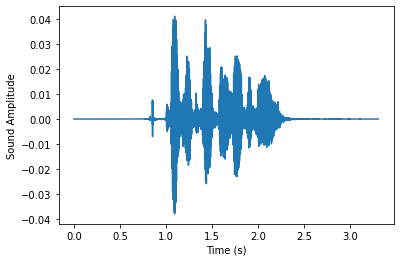

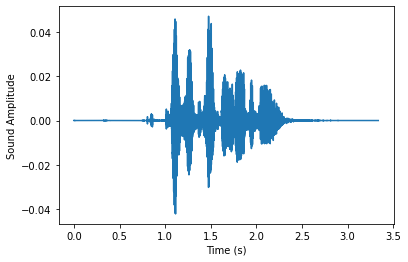

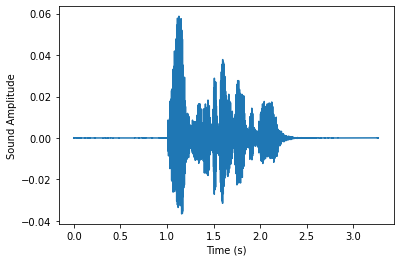

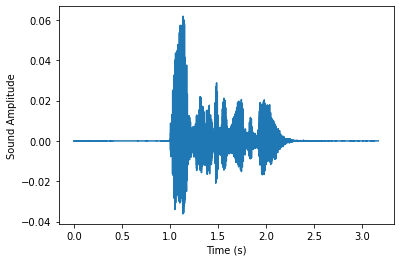

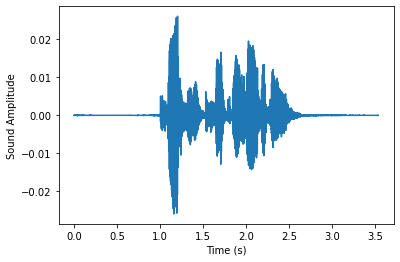

...

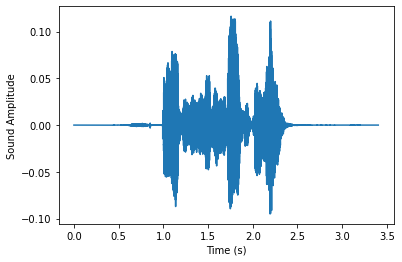

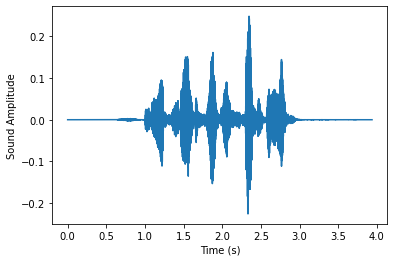

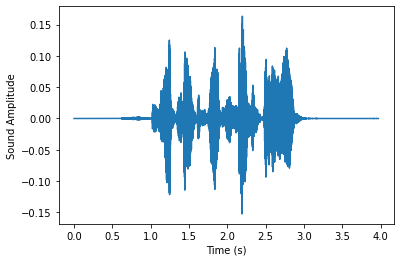

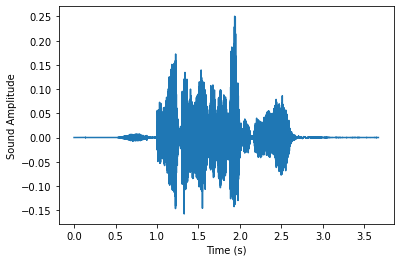

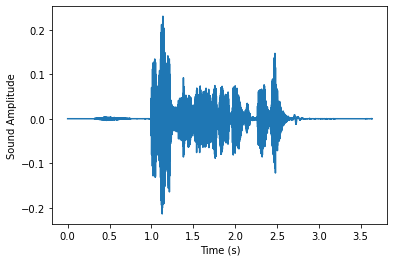

<ipython-input-8-aa566e6b3fc6>:13: WavFileWarning: Chunk (non-data) not understood, skipping it.
  sample_rate , samples = wavfile.read(listOfFiles[file])
<ipython-input-8-aa566e6b3fc6>:15: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(times, frequencies, spectrogram)


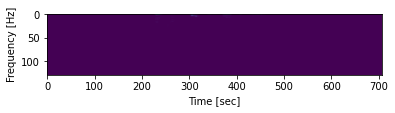

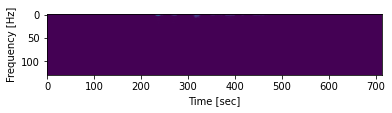

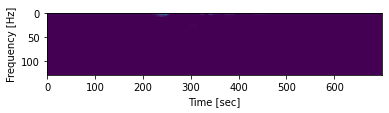

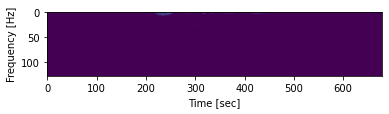

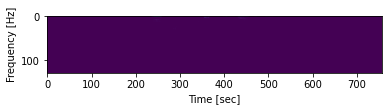

e:\anaconda\lib\site-packages\scipy\signal\spectral.py:1964: UserWarning: nperseg = 256 is greater than input length  = 2, using nperseg = 2
  warnings.warn('nperseg = {0:d} is greater than input length '


ValueError: too many values to unpack (expected 2)

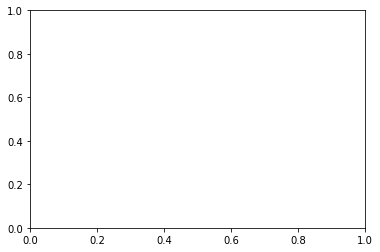

In [8]:
#Plotting the Basic Graphs for understanding of Audio Files :
for file in range(0 , len(listOfFiles) , 1):
    audio , sfreq = lr.load(listOfFiles[file])
    time = np.arange(0 , len(audio)) / sfreq
    
    fig ,ax = plt.subplots()
    ax.plot(time , audio)
    ax.set(xlabel = 'Time (s)' , ylabel = 'Sound Amplitude')
    plt.show()
    
#PLOT THE SEPCTOGRAM
for file in range(0 , len(listOfFiles) , 1):
     sample_rate , samples = wavfile.read(listOfFiles[file])
     frequencies , times, spectrogram = signal.spectrogram(samples, sample_rate) 
     plt.pcolormesh(times, frequencies, spectrogram)
     plt.imshow(spectrogram)
     plt.ylabel('Frequency [Hz]')
     plt.xlabel('Time [sec]')
     plt.show()

In [10]:
#Next Step is In-Depth Visualisation of Audio Fiels and its certain features to plot for.
#They are the Plotting Functions to be called later. 
def plot_signals(signals):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Time Series' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            axes[x,y].set_title(list(signals.keys())[i])
            axes[x,y].plot(list(signals.values())[i])
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1

def plot_fft(fft):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Fourier Transform' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            data = list(fft.values())[i]
            Y,freq = data[0] , data[1]
            axes[x,y].set_title(list(fft.keys())[i])
            axes[x,y].plot(freq , Y)
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1
    
def plot_fbank(fbank):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Filter Bank Coefficients' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            axes[x,y].set_title(list(fbank.keys())[i])
            axes[x,y].imshow(list(fbank.values())[i],cmap='hot', interpolation = 'nearest')
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1
            
def plot_mfccs(mfccs):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Mel Frequency Capstrum  Coefficients' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            axes[x,y].set_title(list(mfccs.keys())[i])
            axes[x,y].imshow(list(mfccs.values())[i],
                             cmap='hot', interpolation = 'nearest')
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1

def calc_fft(y,rate):
    n = len(y)
    freq = np.fft.rfftfreq(n , d= 1/rate)
    Y= abs(np.fft.rfft(y)/n)
    return(Y,freq)

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


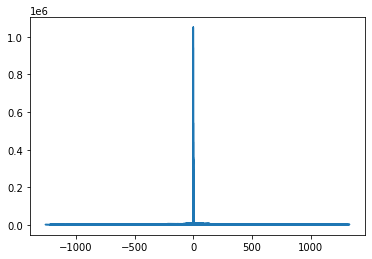

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


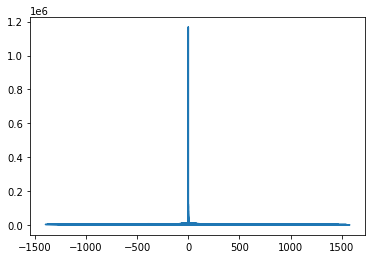

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


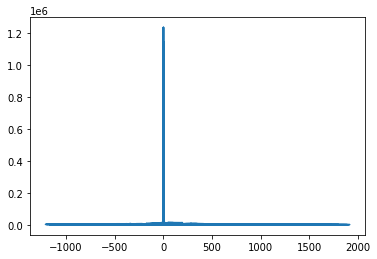

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


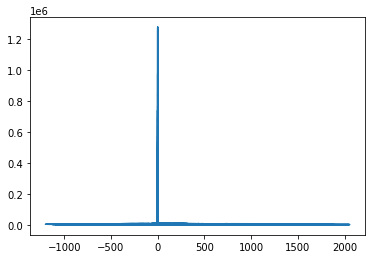

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


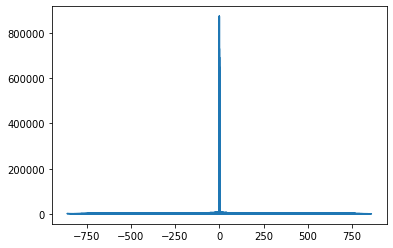

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


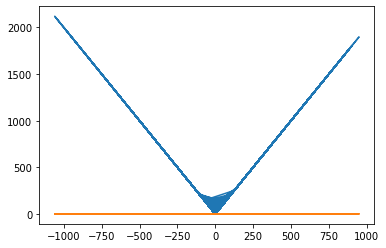

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


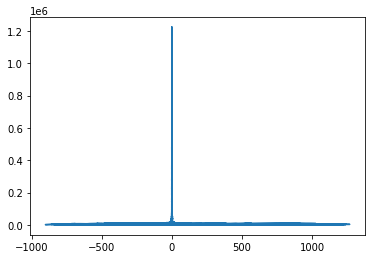

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


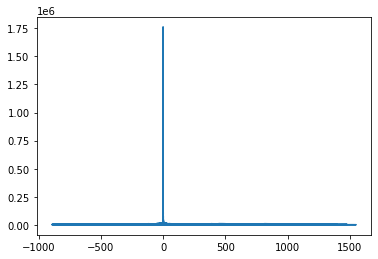

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


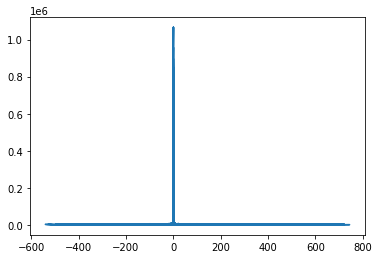

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


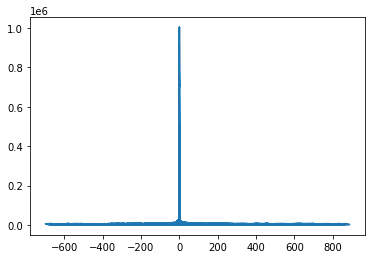

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


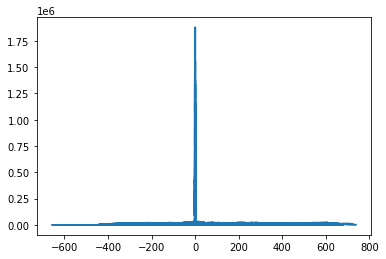

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


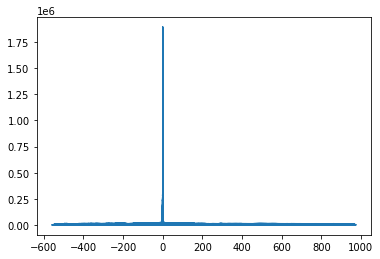

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


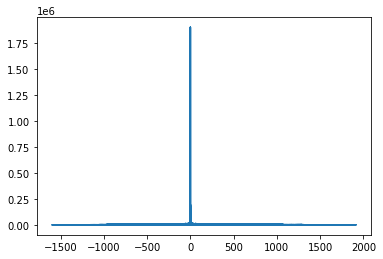

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


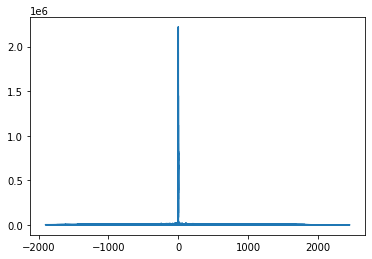

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


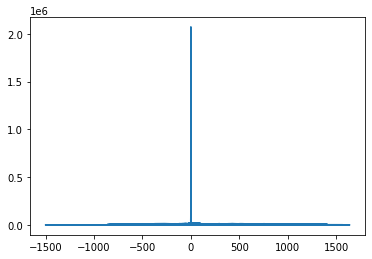

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


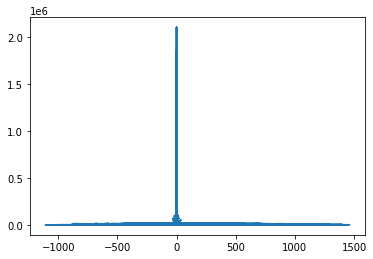

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


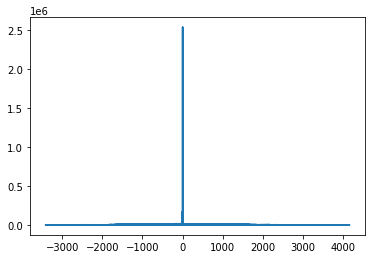

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


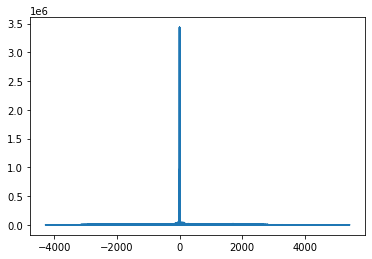

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


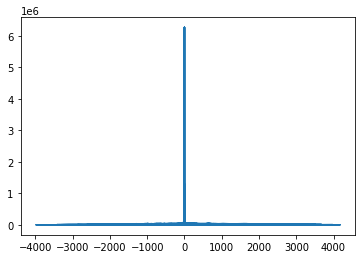

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


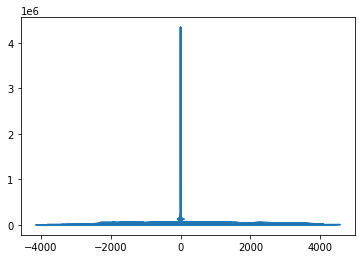

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


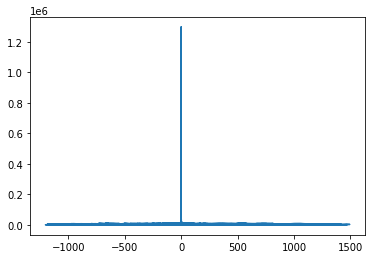

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


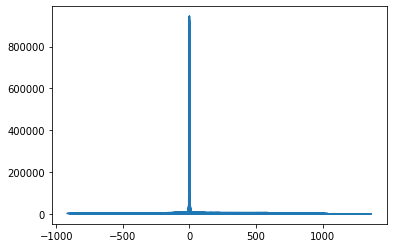

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


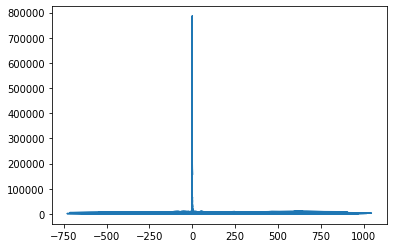

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


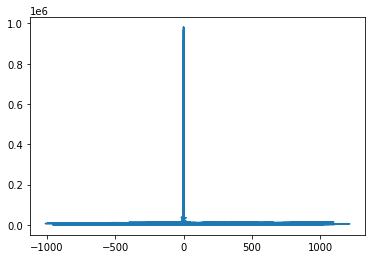

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


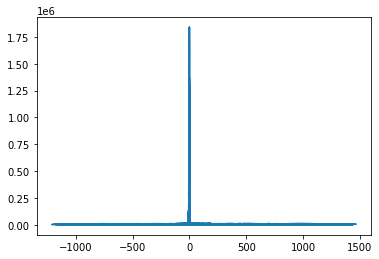

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


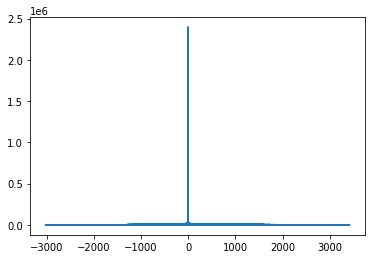

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


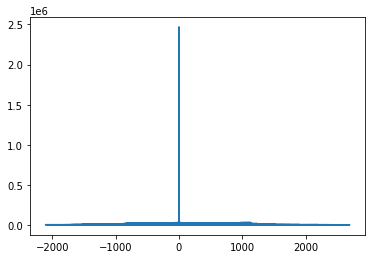

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


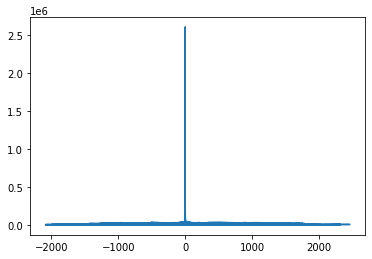

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


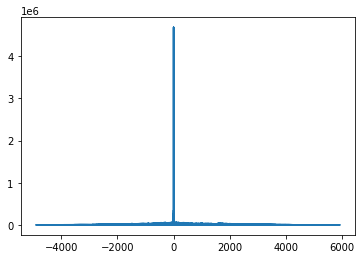

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


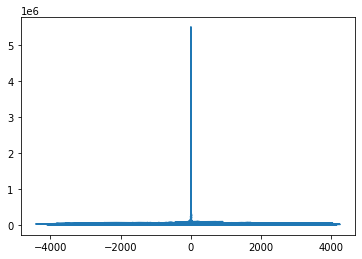

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


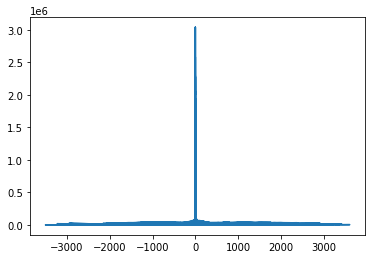

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


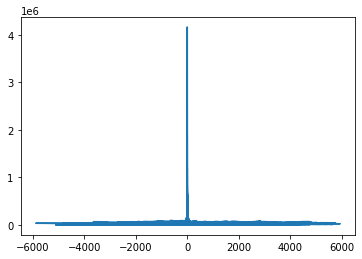

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


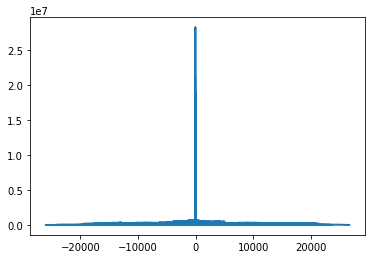

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


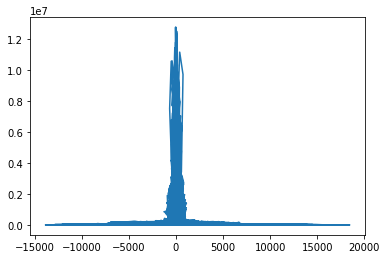

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


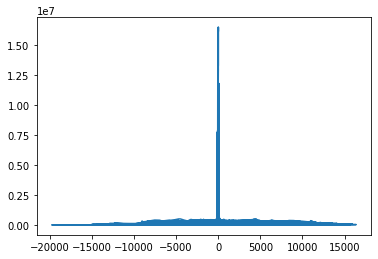

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


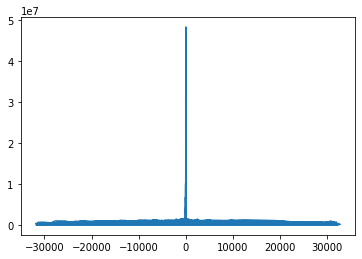

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


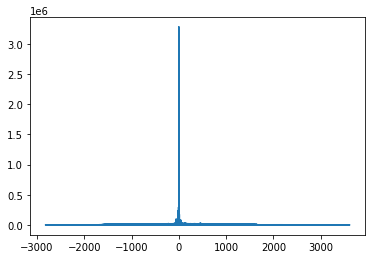

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


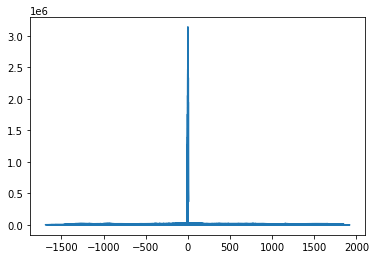

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


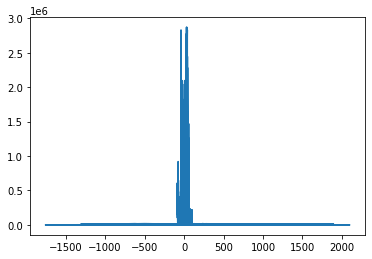

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


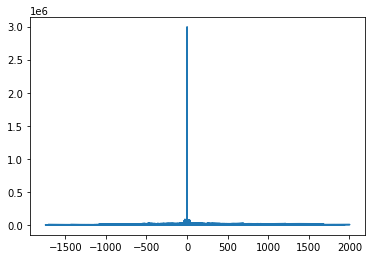

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


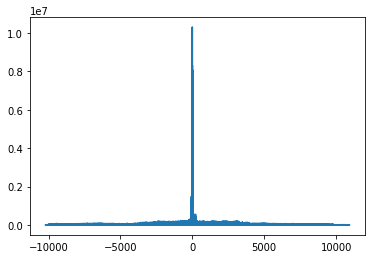

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


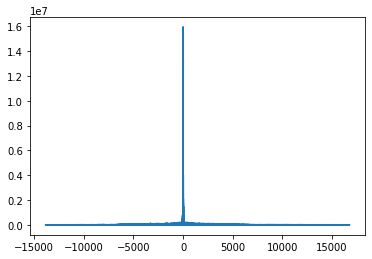

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


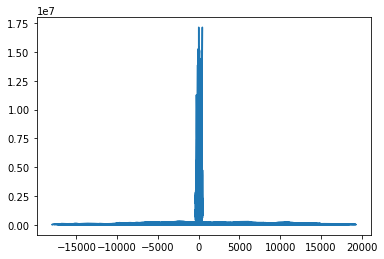

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


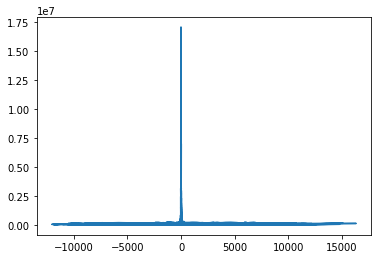

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


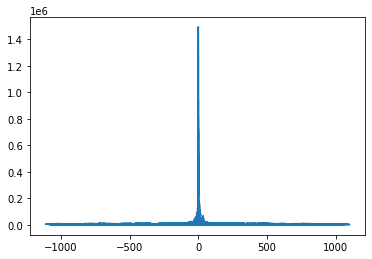

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


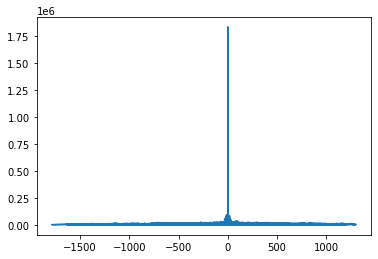

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


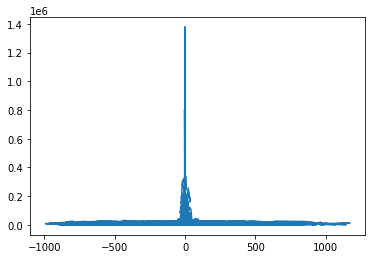

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


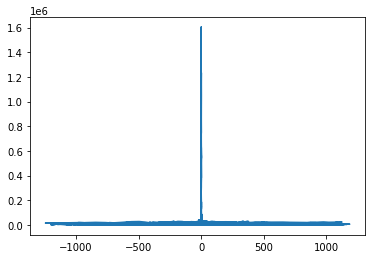

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


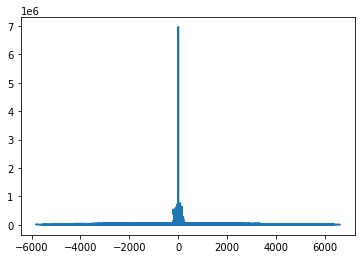

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


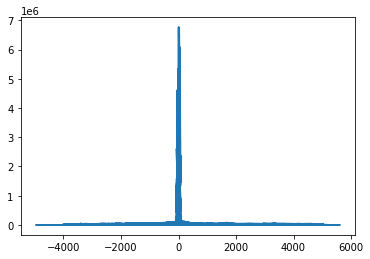

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


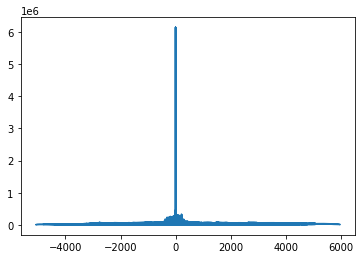

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


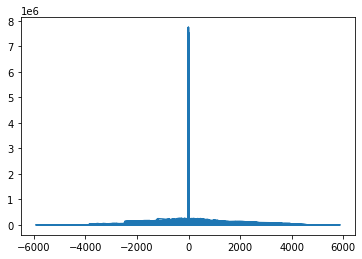

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


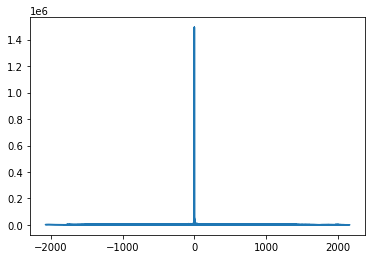

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


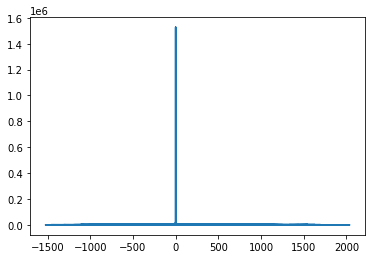

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


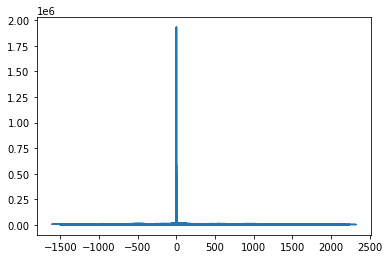

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


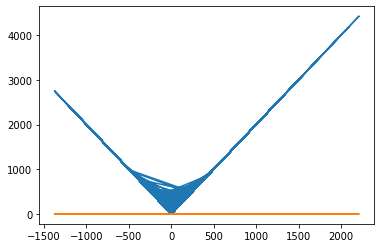

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


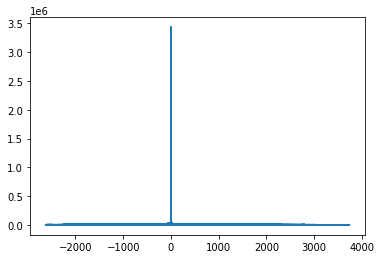

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


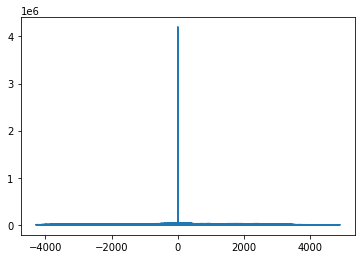

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


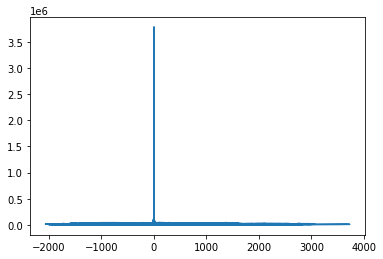

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


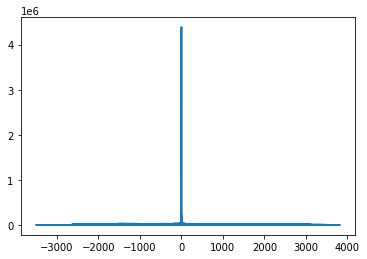

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


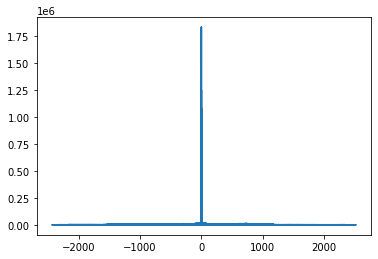

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


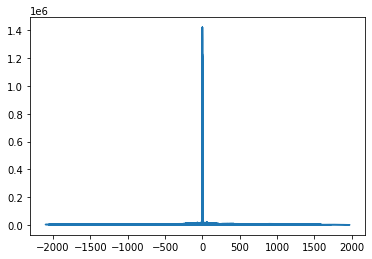

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


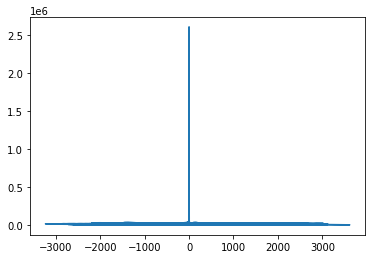

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


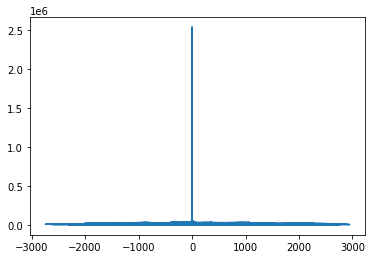

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


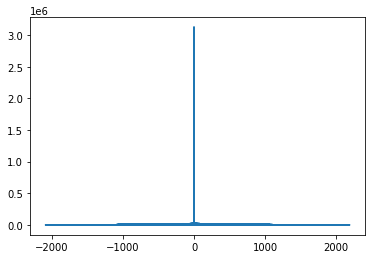

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


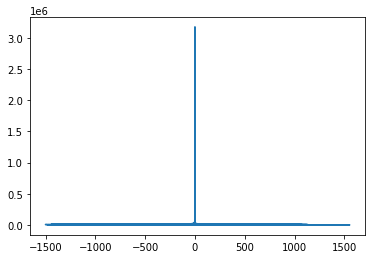

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


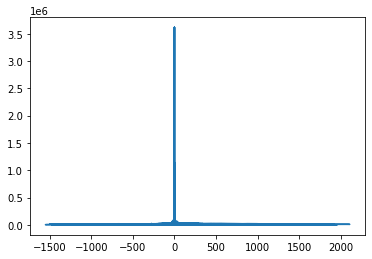

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


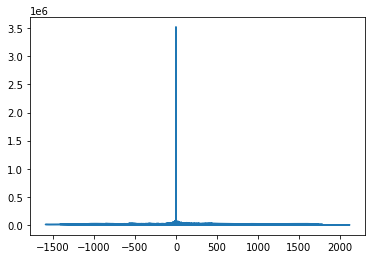

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


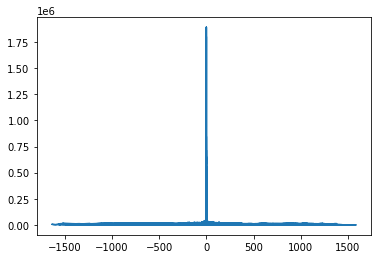

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


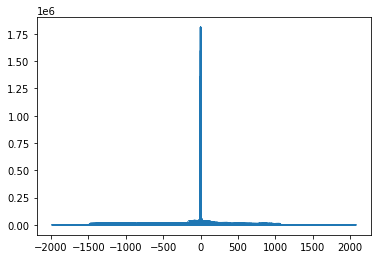

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


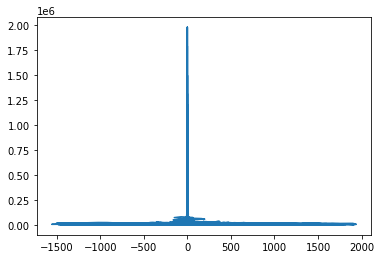

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


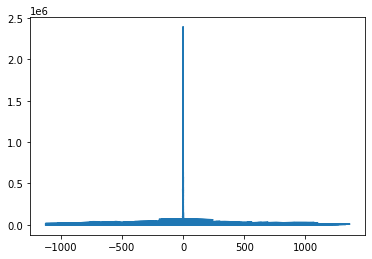

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


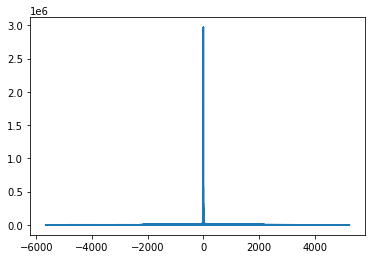

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


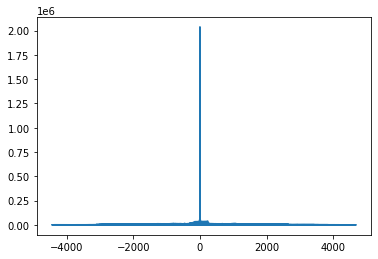

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


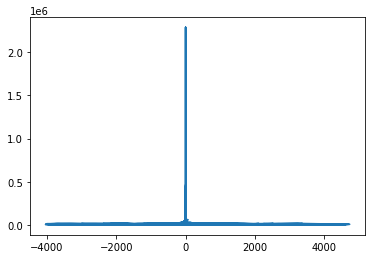

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


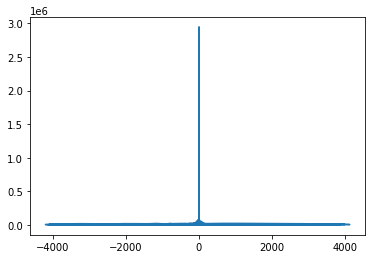

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


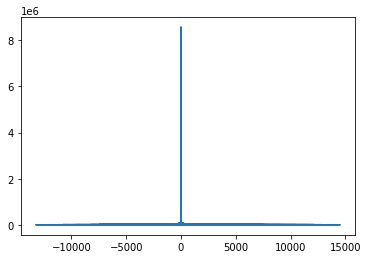

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


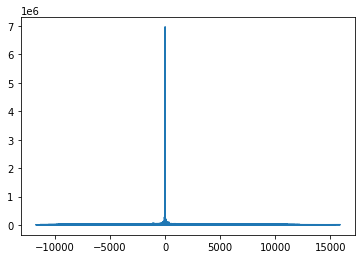

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


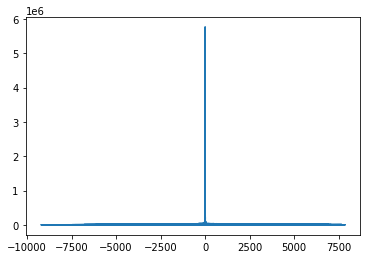

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


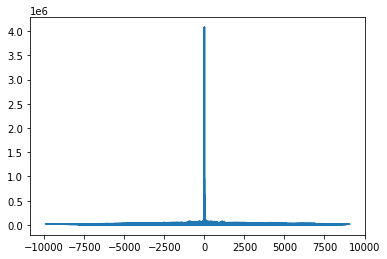

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


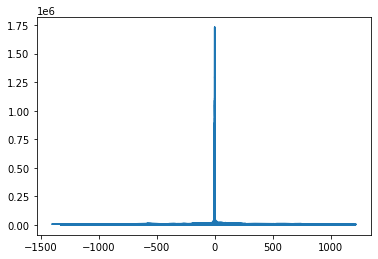

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


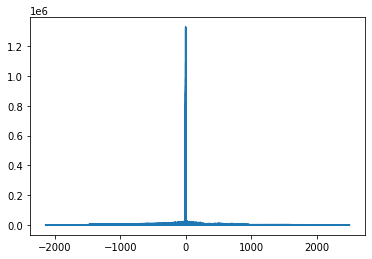

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


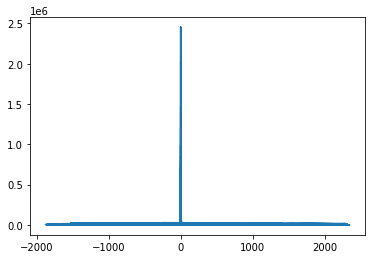

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


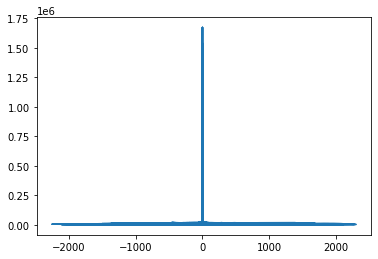

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


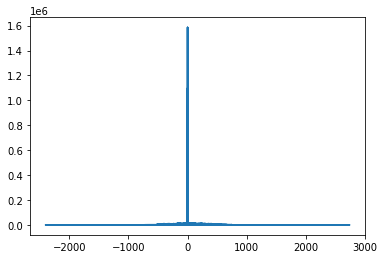

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


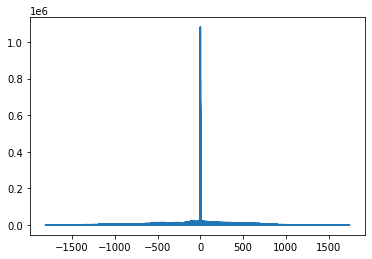

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


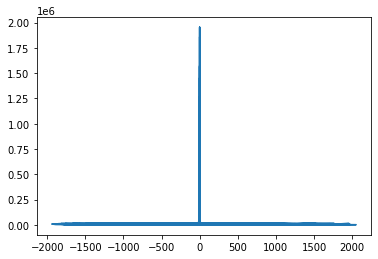

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


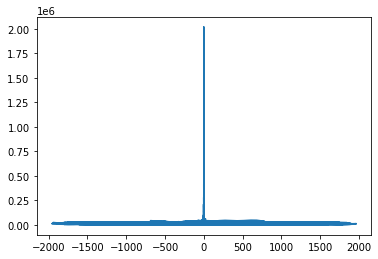

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


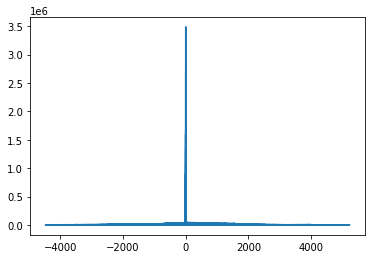

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


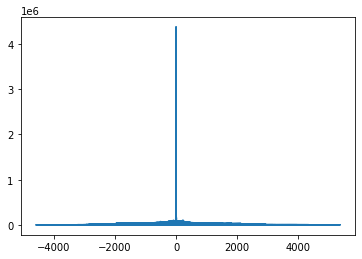

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


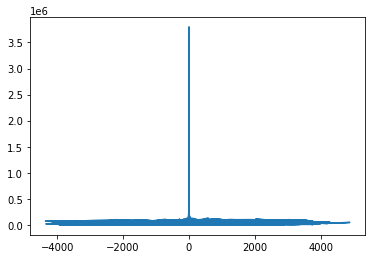

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


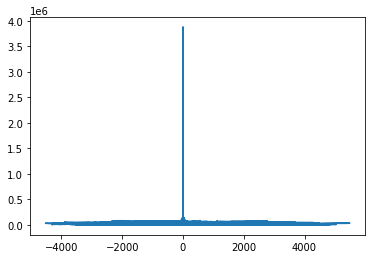

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


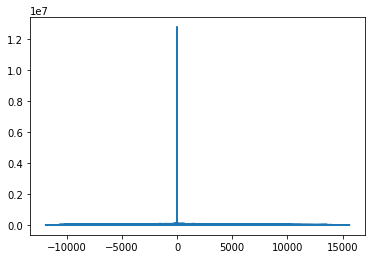

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


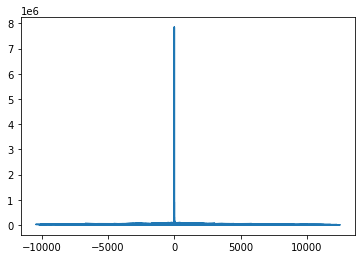

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


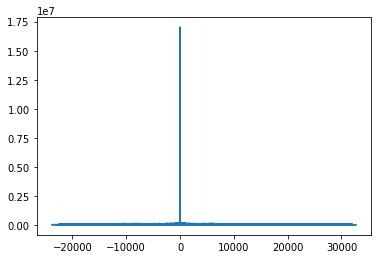

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


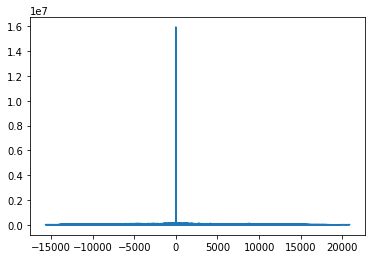

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


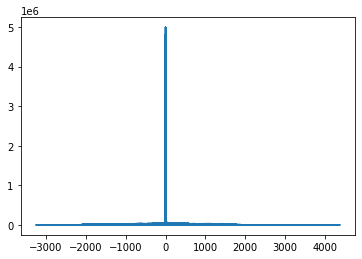

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


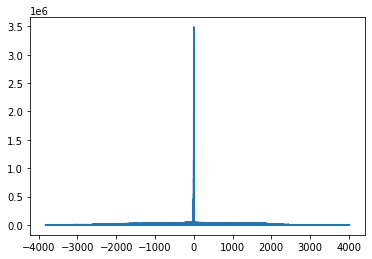

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


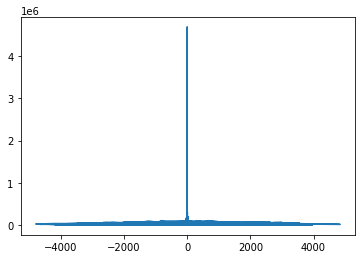

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


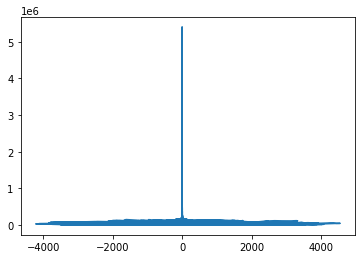

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


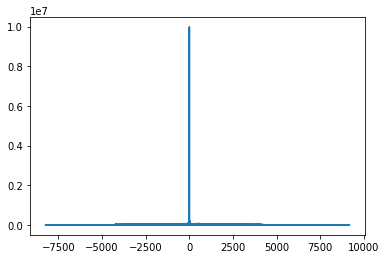

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


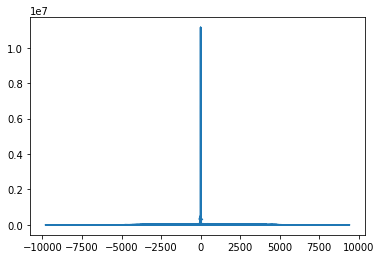

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


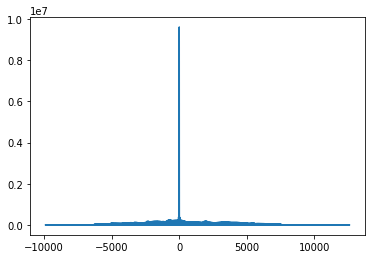

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


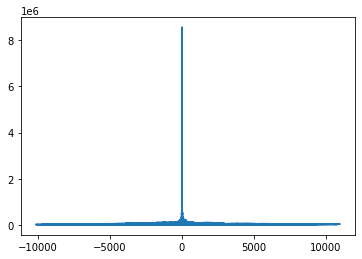

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


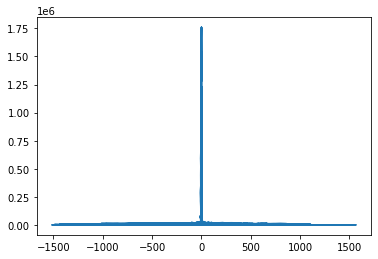

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


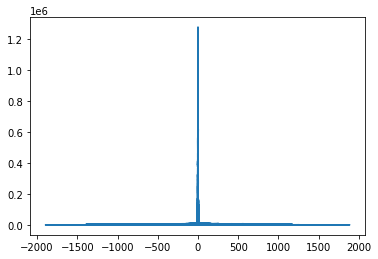

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


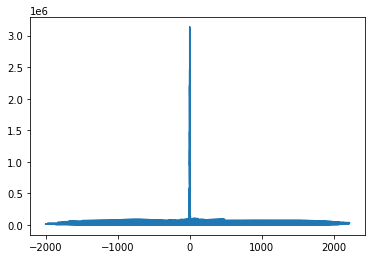

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


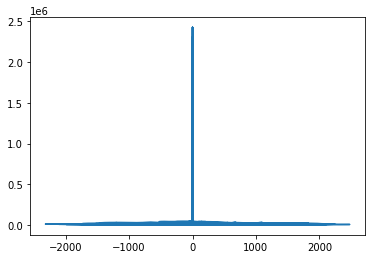

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


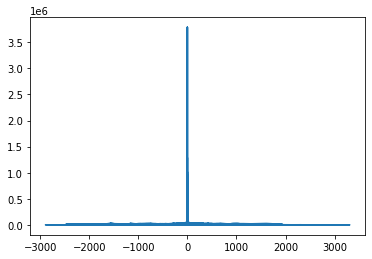

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


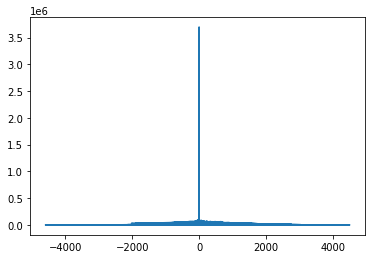

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


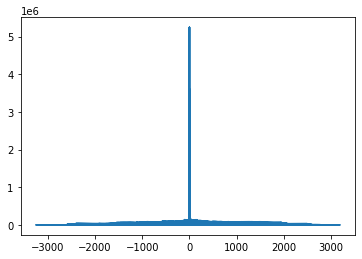

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


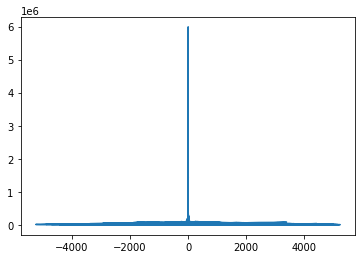

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


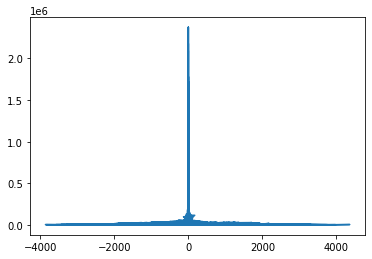

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


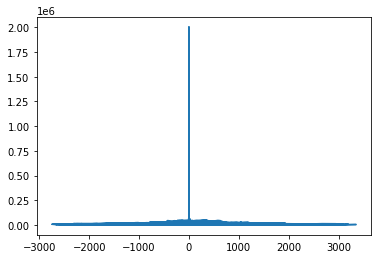

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


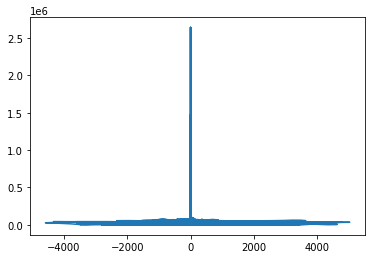

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


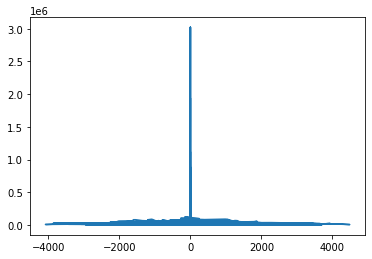

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


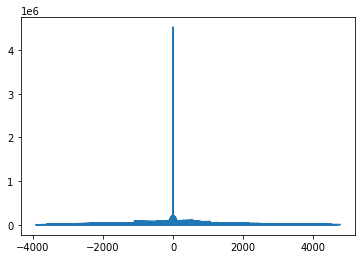

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


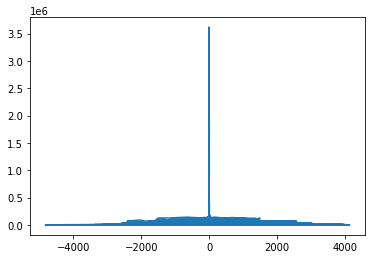

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


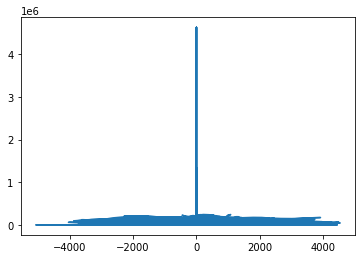

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


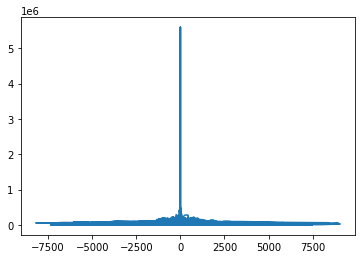

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


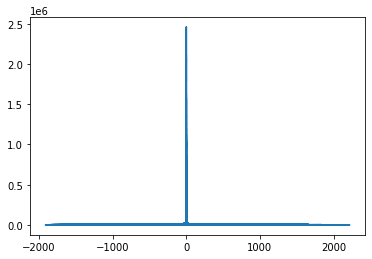

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


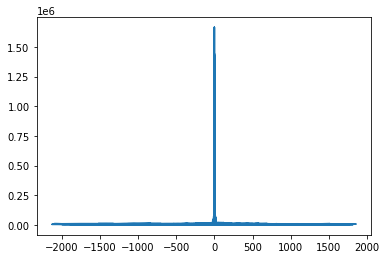

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


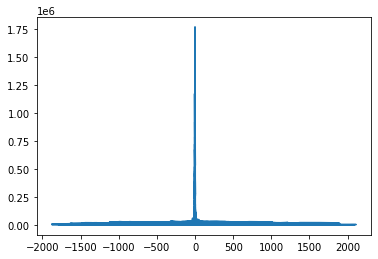

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


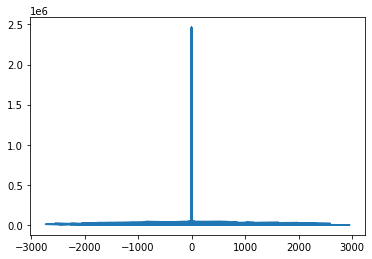

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


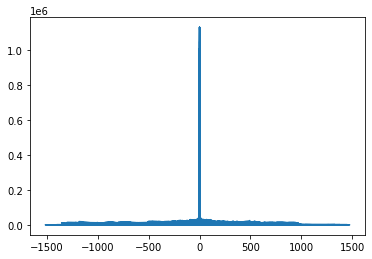

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


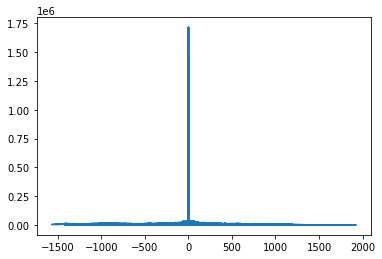

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


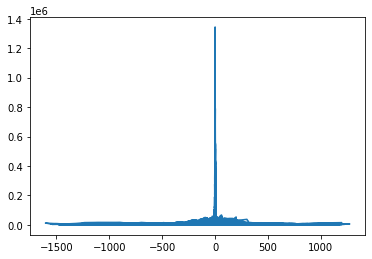

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


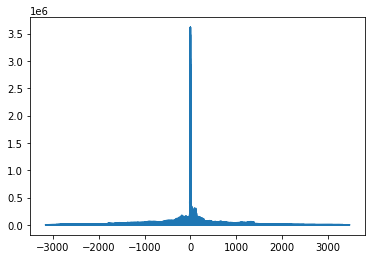

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


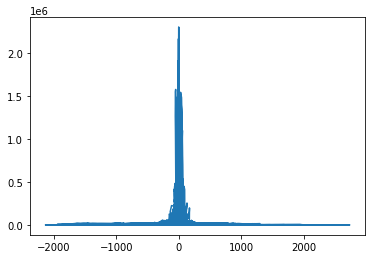

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


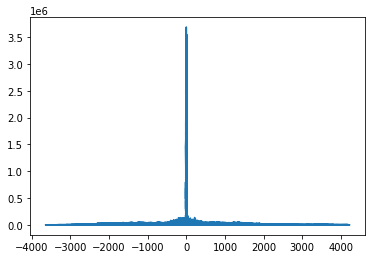

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


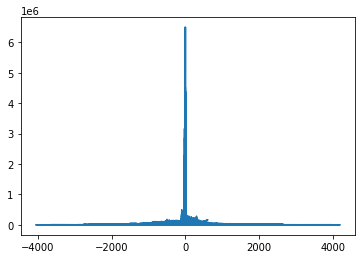

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


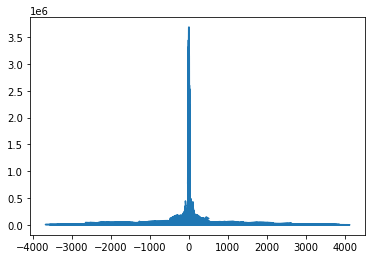

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


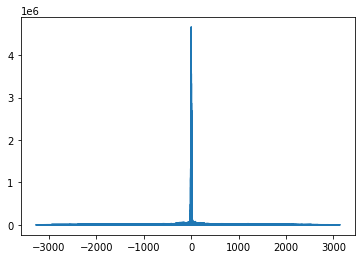

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


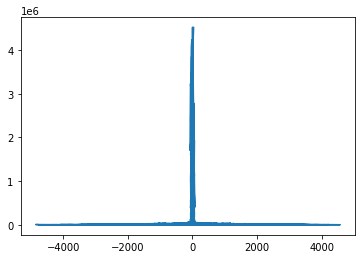

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


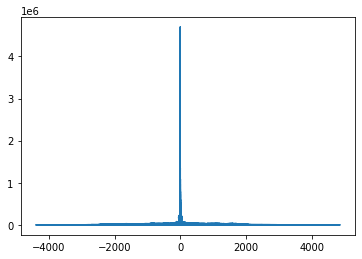

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


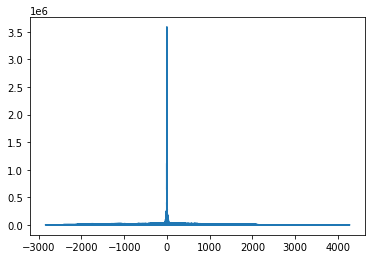

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


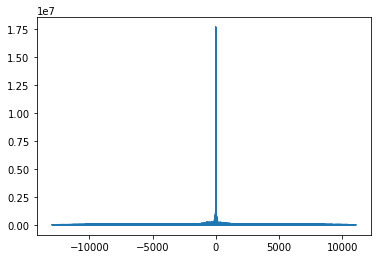

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


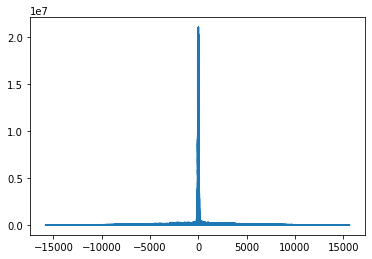

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


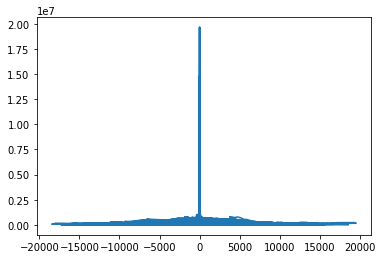

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


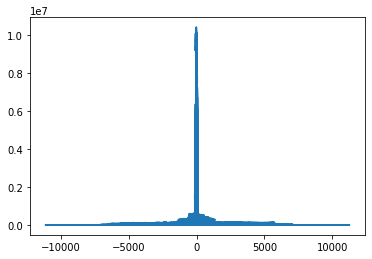

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


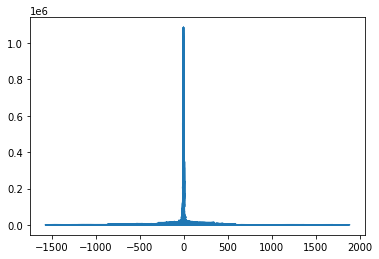

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


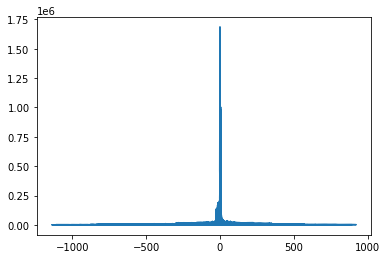

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


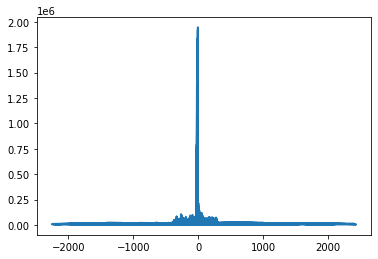

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


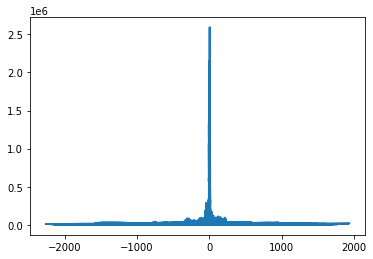

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


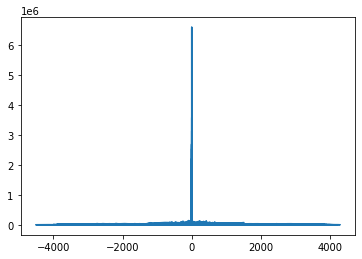

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


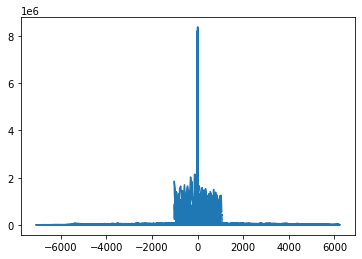

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


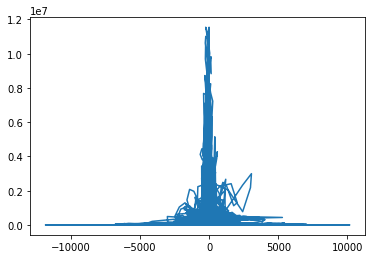

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


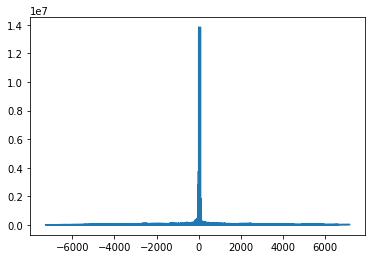

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


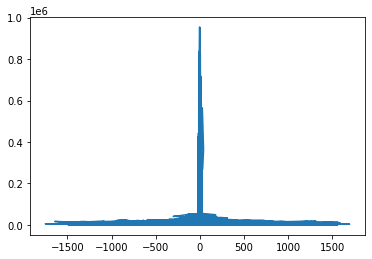

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


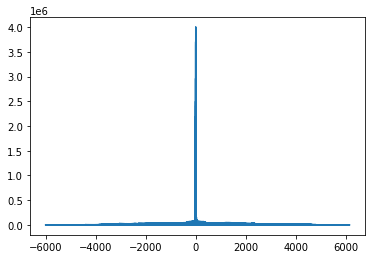

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


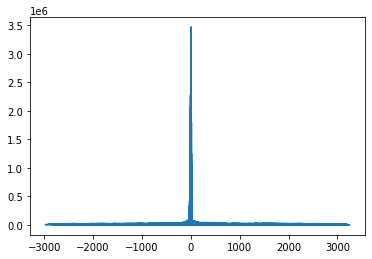

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


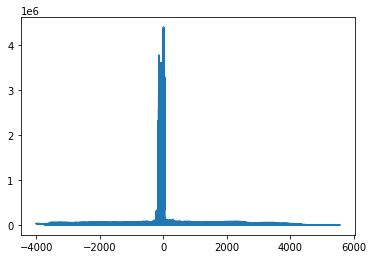

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


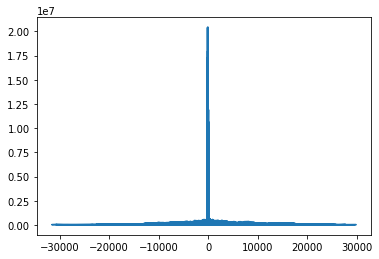

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


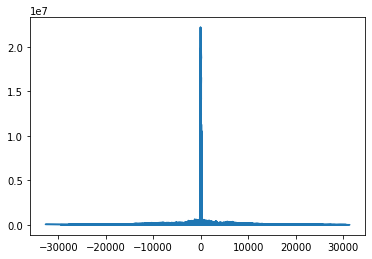

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


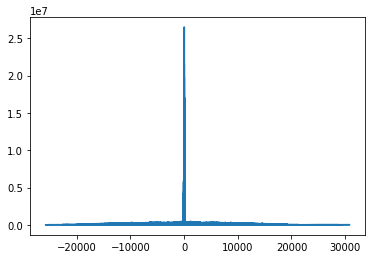

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


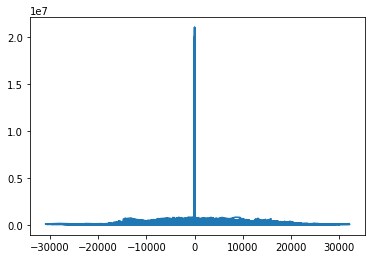

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


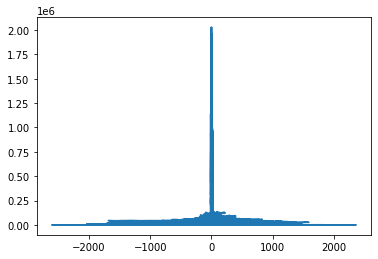

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


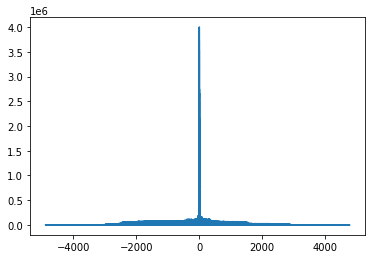

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


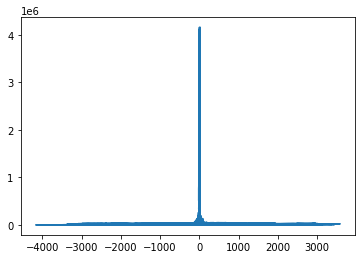

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


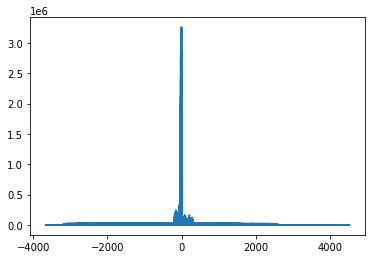

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


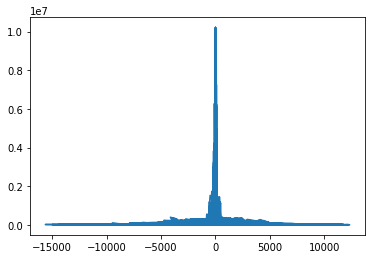

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


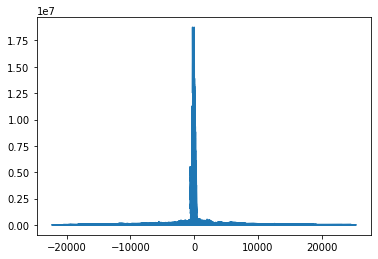

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


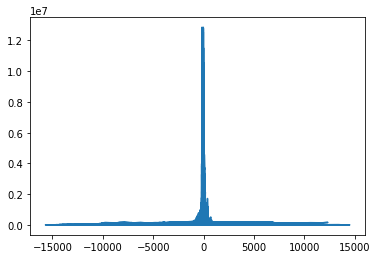

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


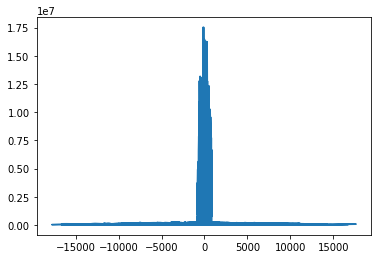

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


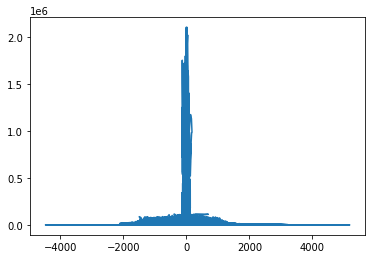

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


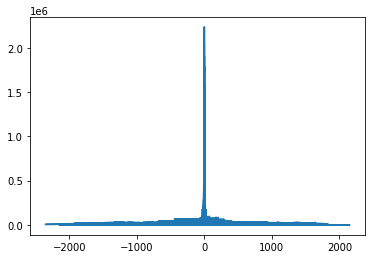

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


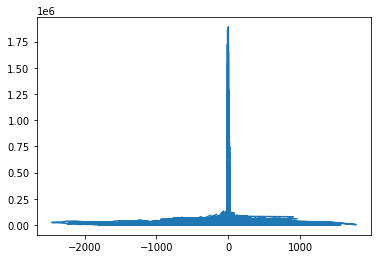

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


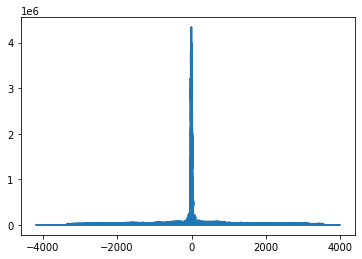

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


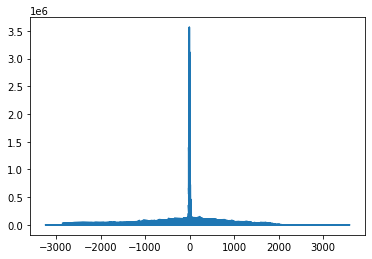

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


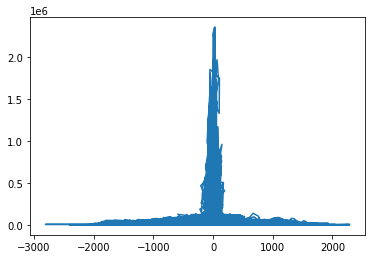

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


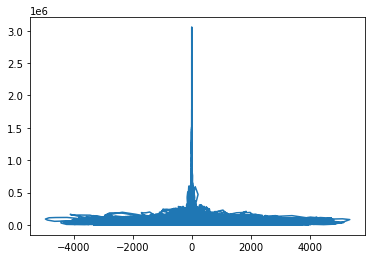

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


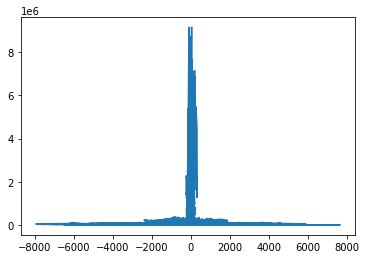

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


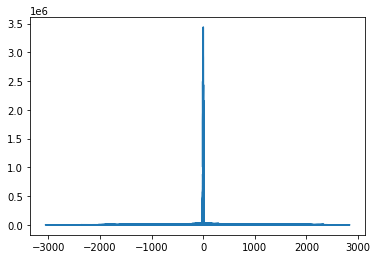

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


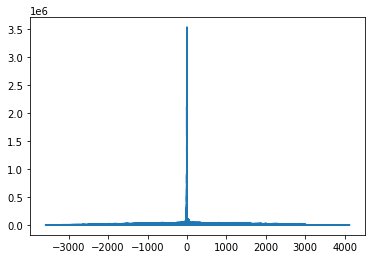

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


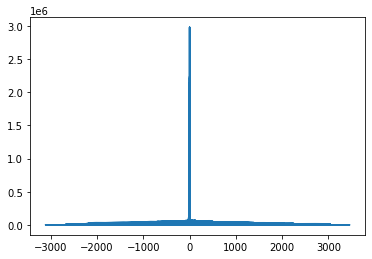

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


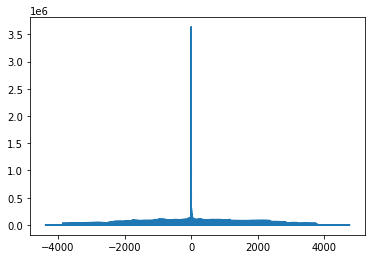

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


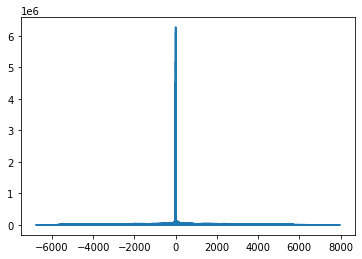

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


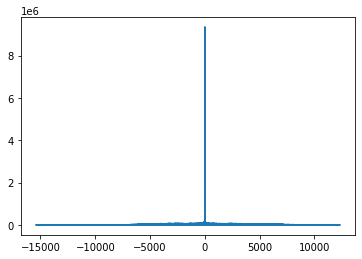

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


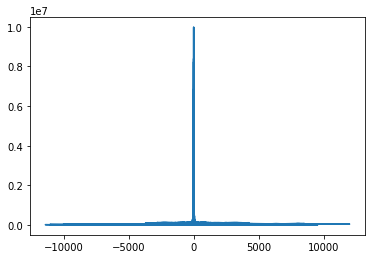

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


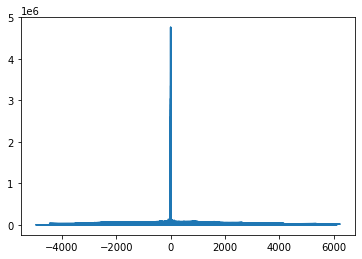

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


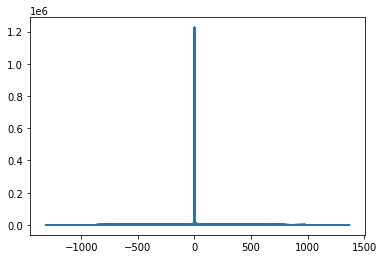

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


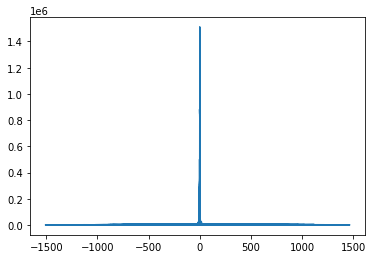

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


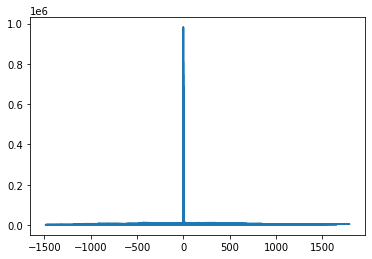

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


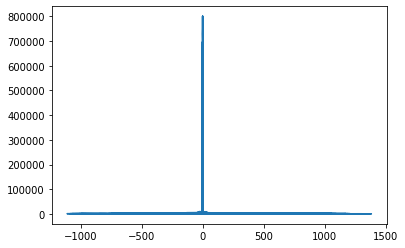

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


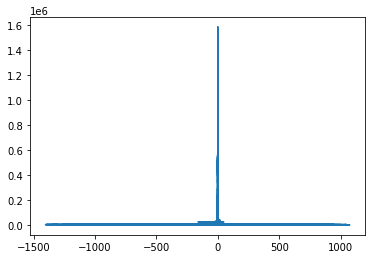

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


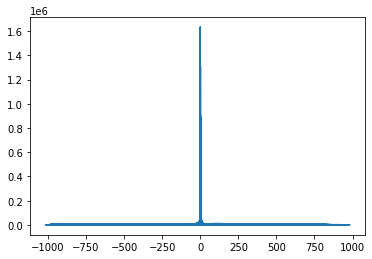

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


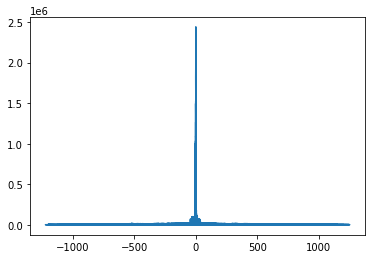

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


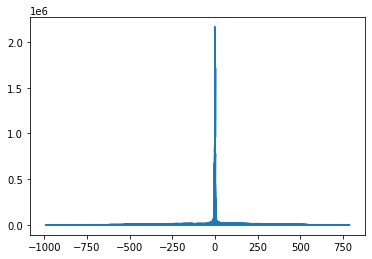

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


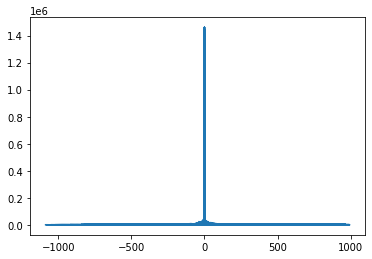

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


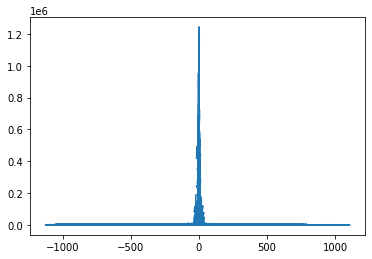

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


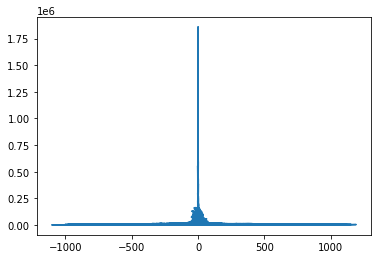

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


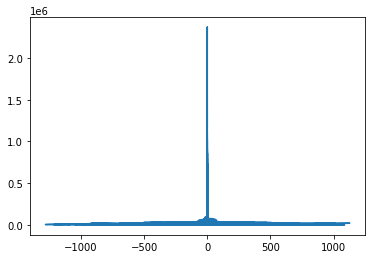

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


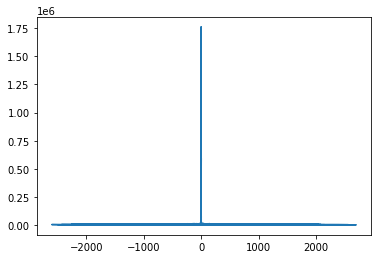

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


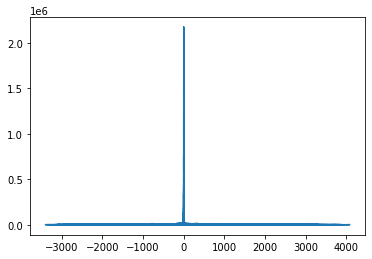

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


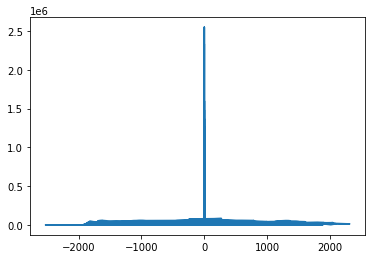

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


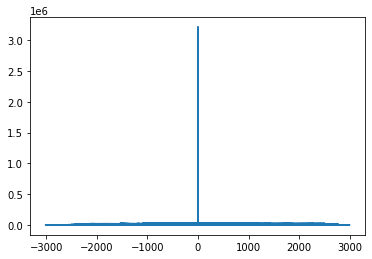

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


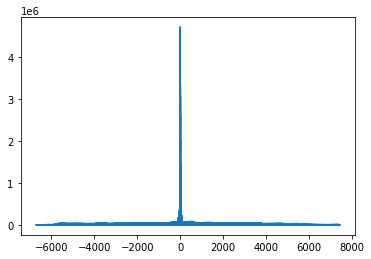

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


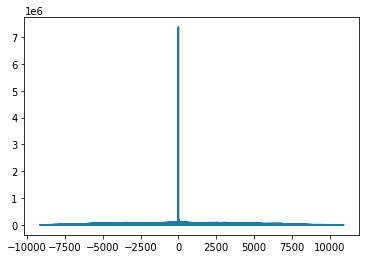

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


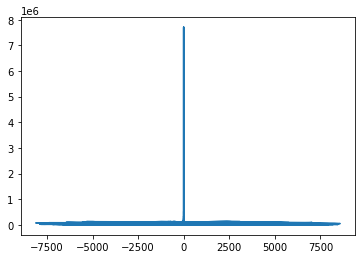

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


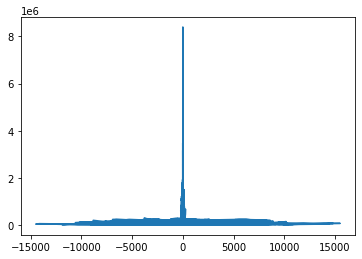

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


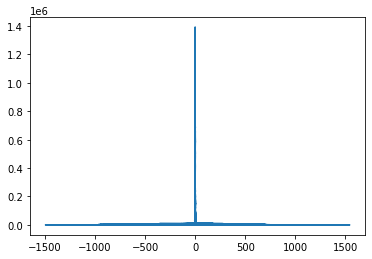

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


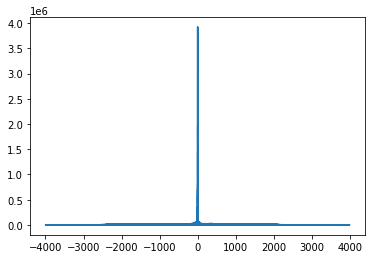

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


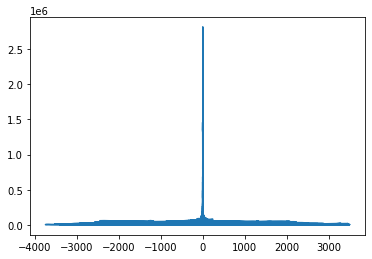

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


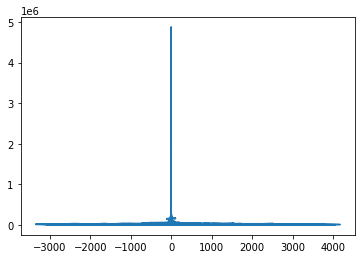

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


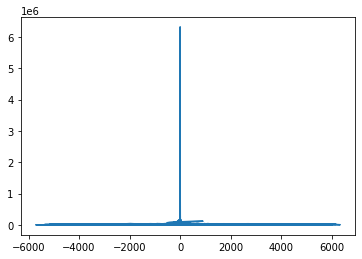

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


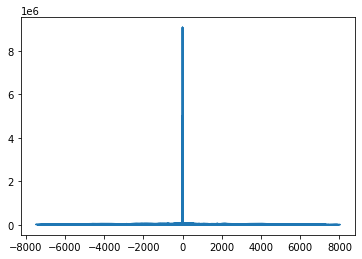

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


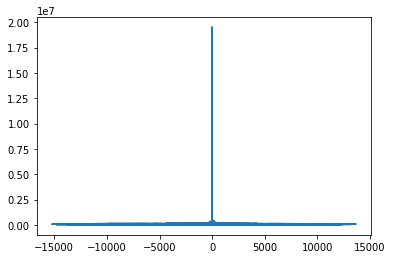

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


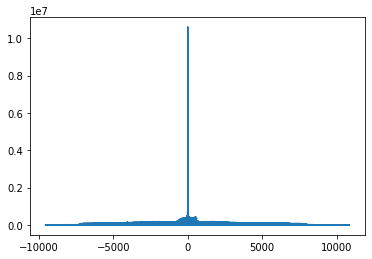

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


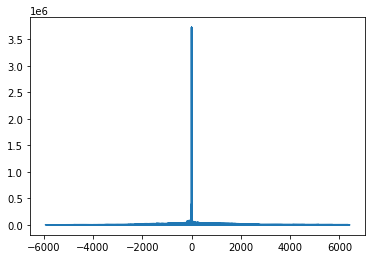

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


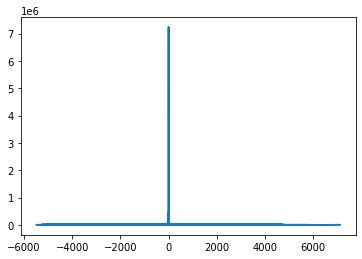

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


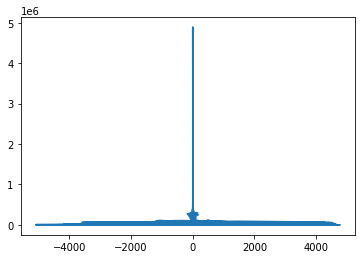

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


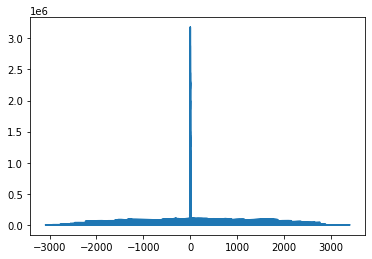

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


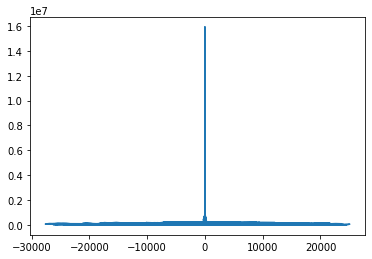

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


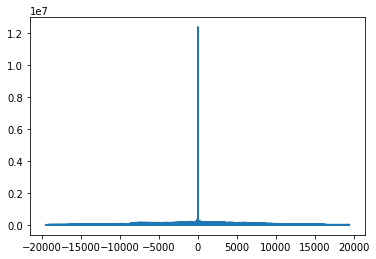

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


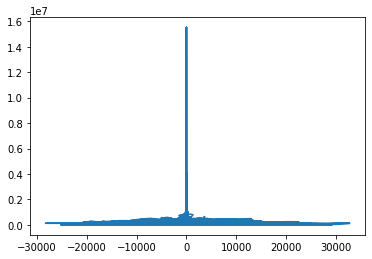

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


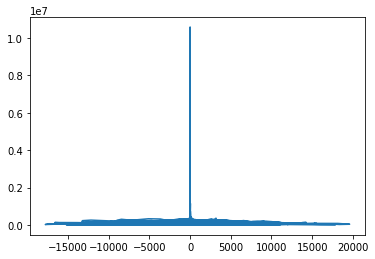

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


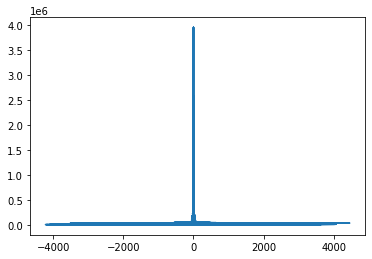

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


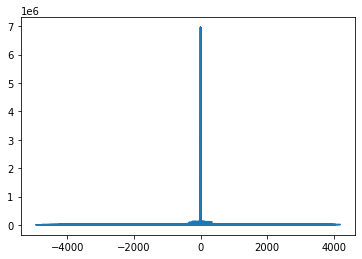

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


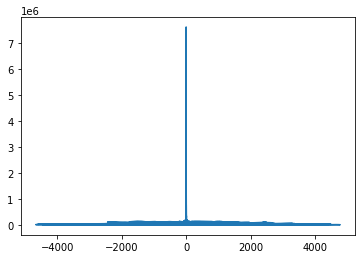

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


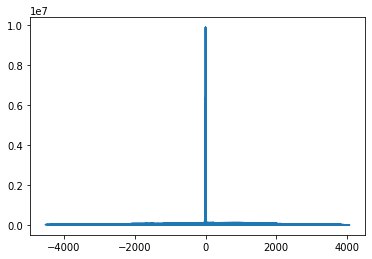

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


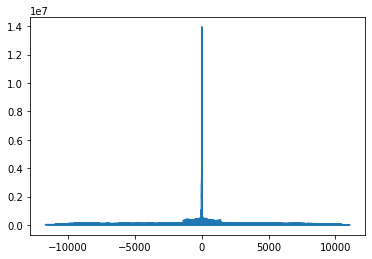

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


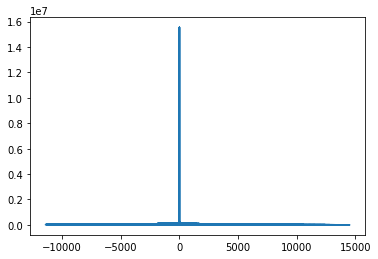

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


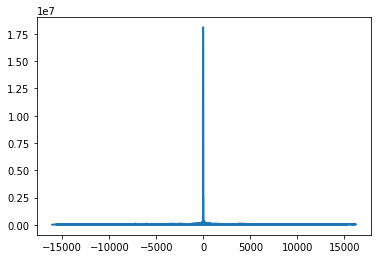

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


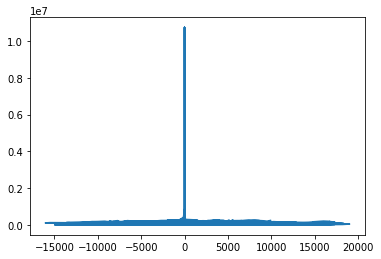

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


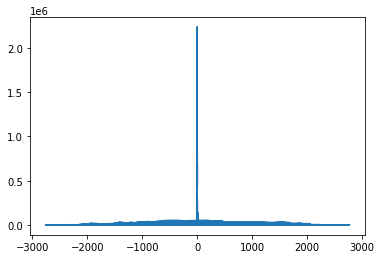

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


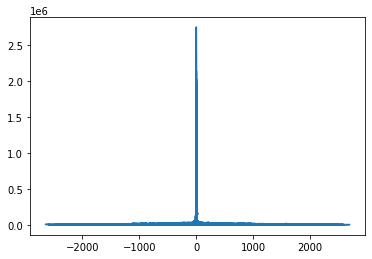

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


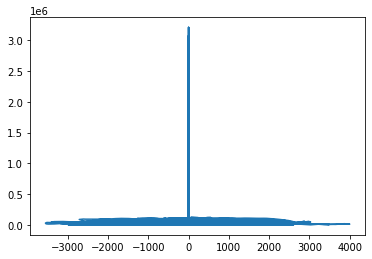

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


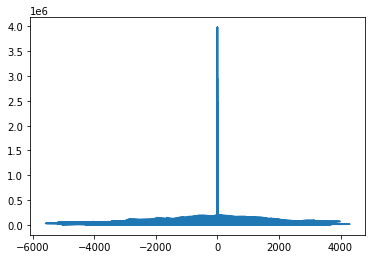

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


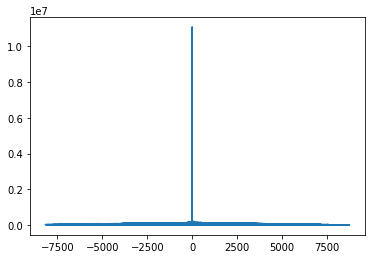

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


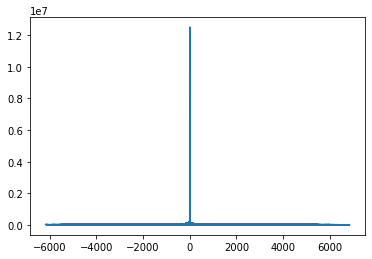

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


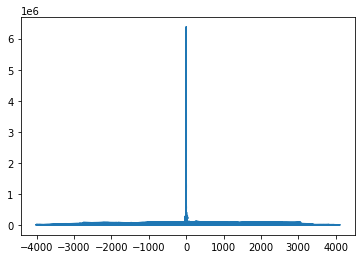

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


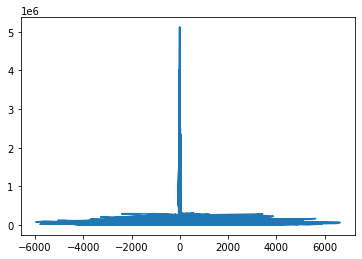

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


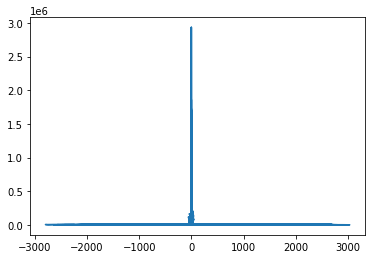

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


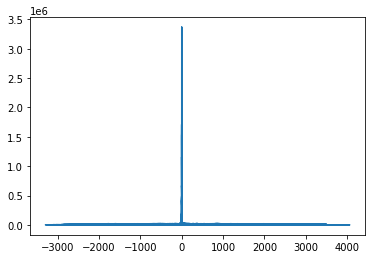

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


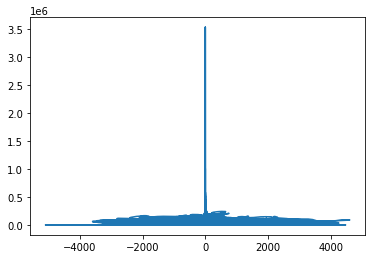

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


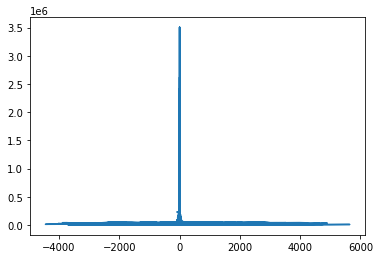

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


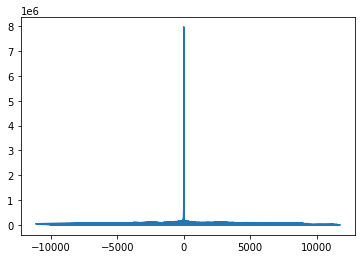

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


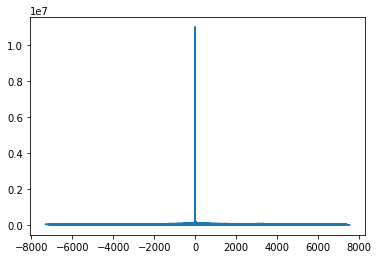

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


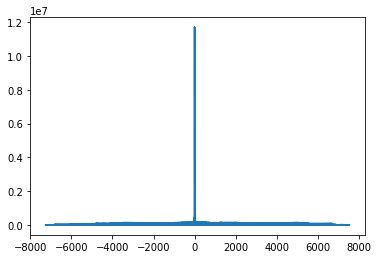

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


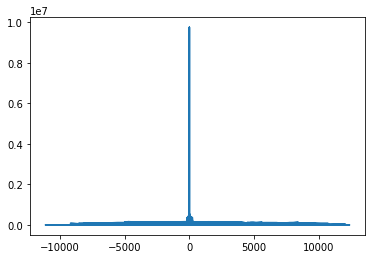

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


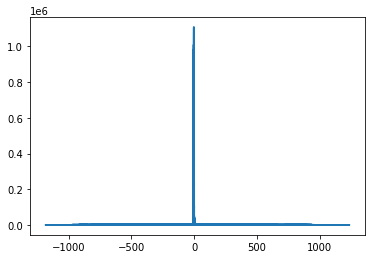

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


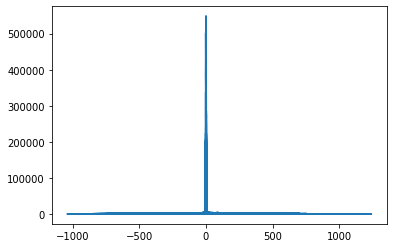

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


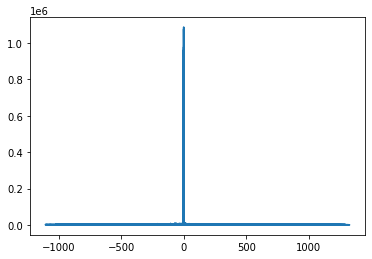

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


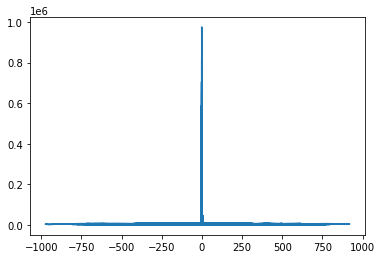

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


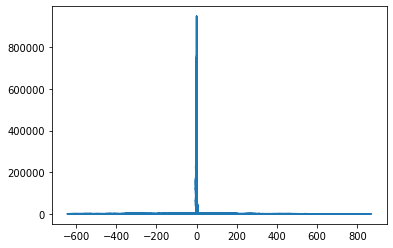

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


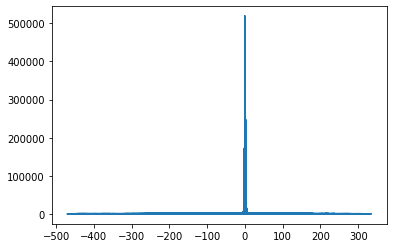

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


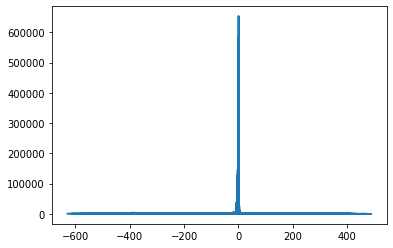

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


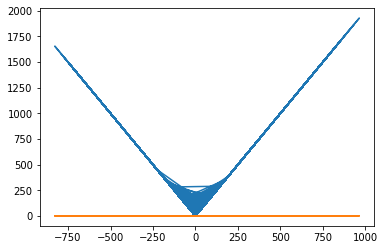

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


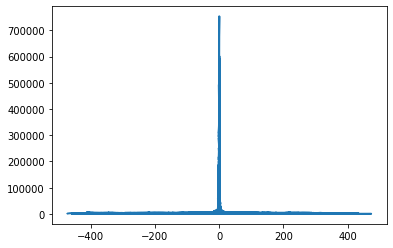

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


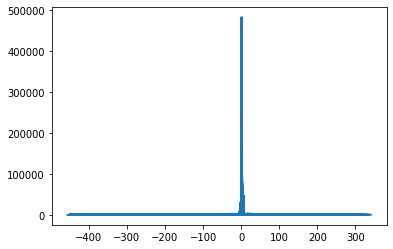

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


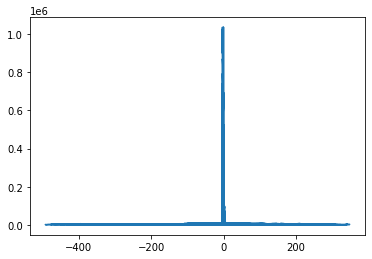

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


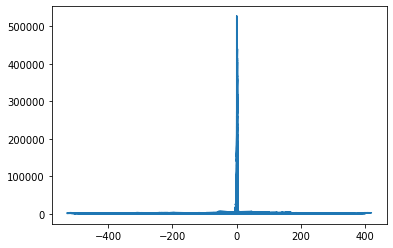

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


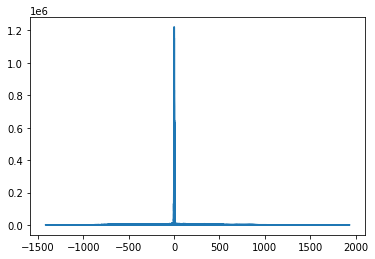

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


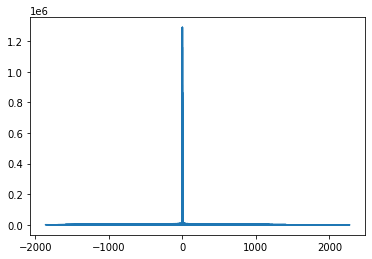

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


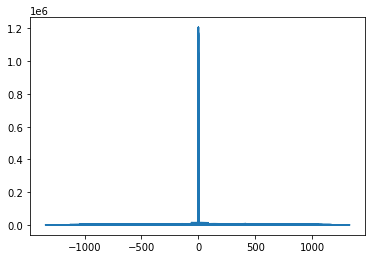

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


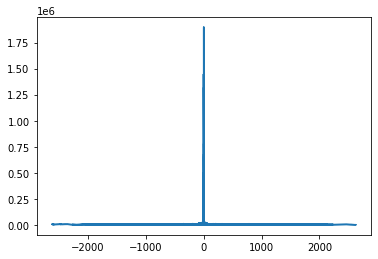

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


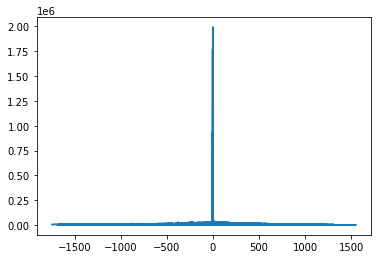

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


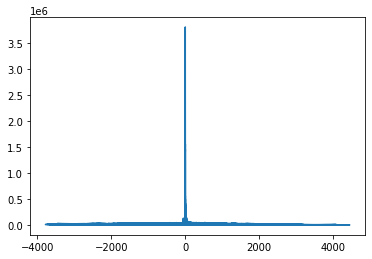

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


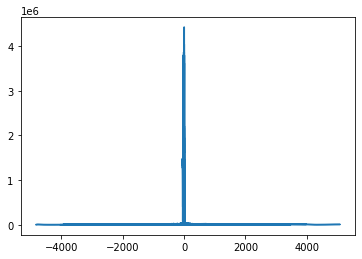

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


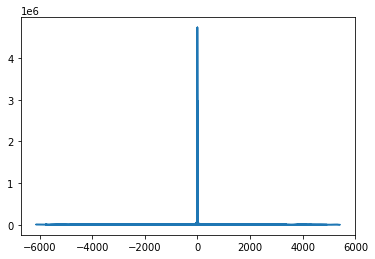

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


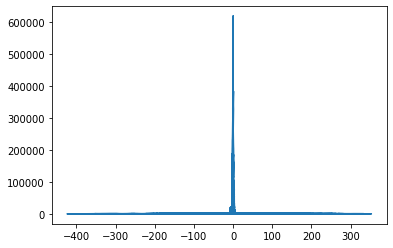

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


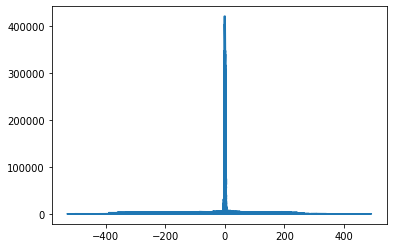

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


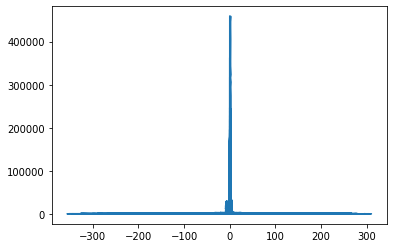

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


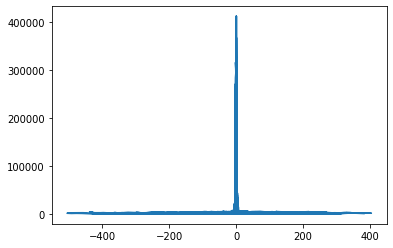

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


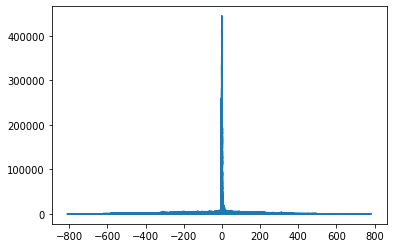

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


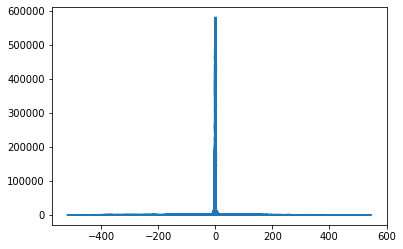

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


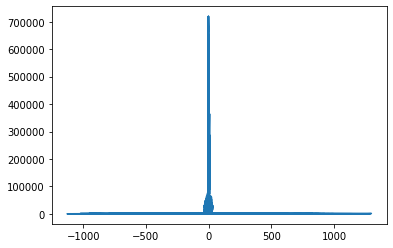

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


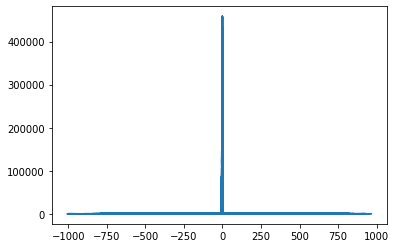

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


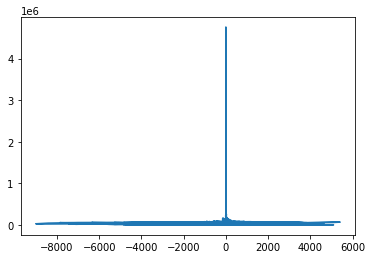

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


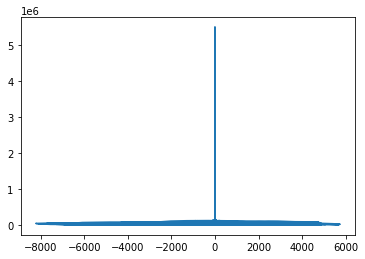

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


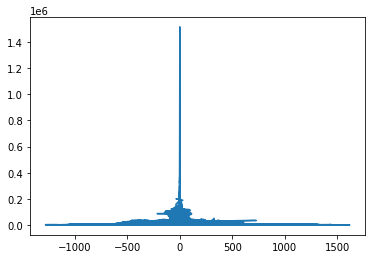

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


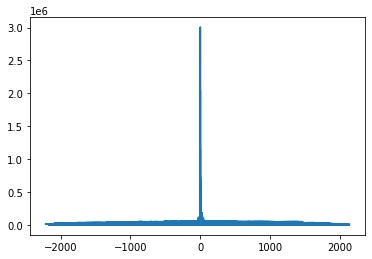

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


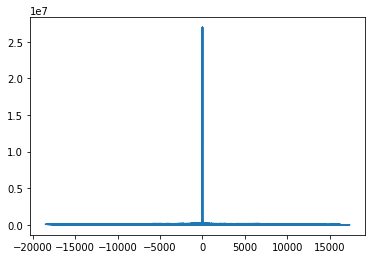

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


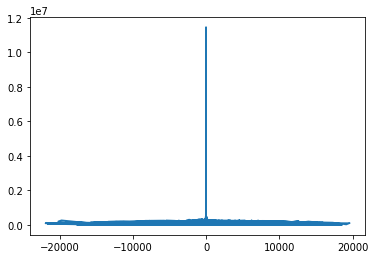

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


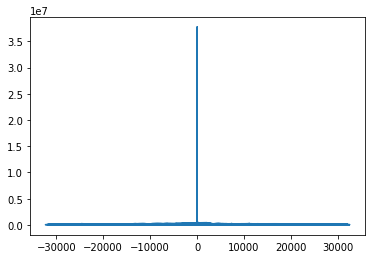

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


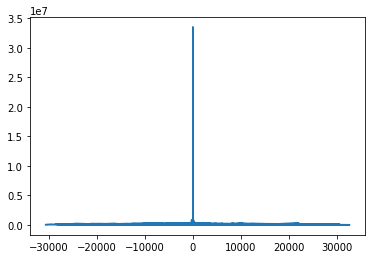

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


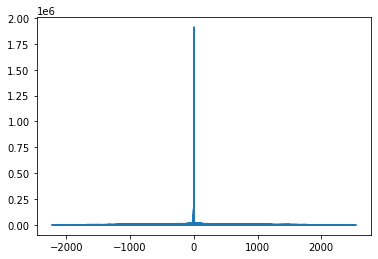

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


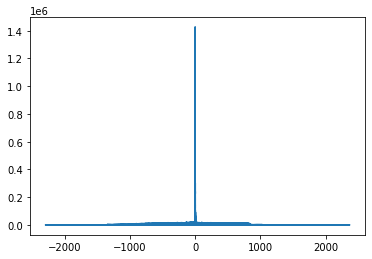

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


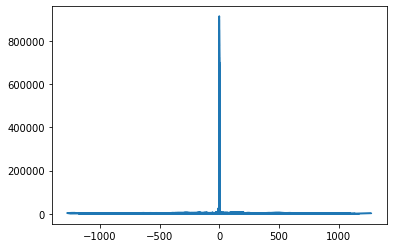

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


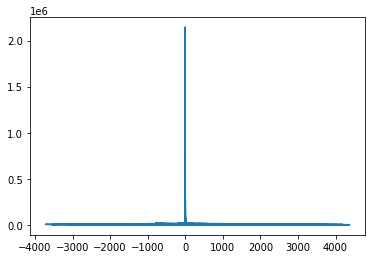

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


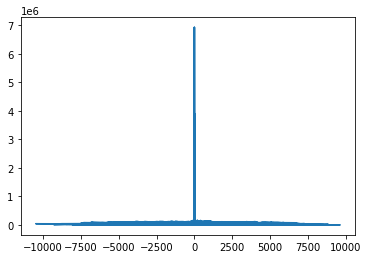

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


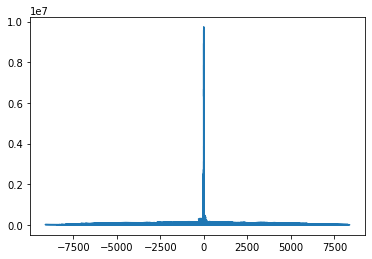

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


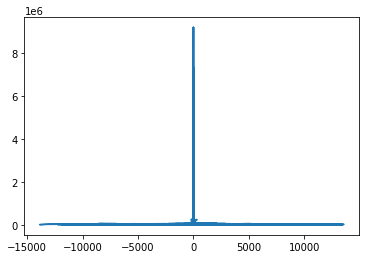

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


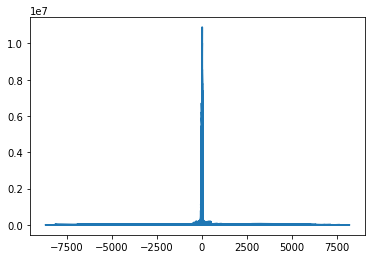

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


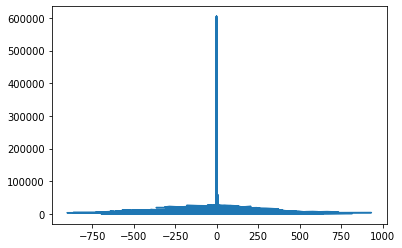

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


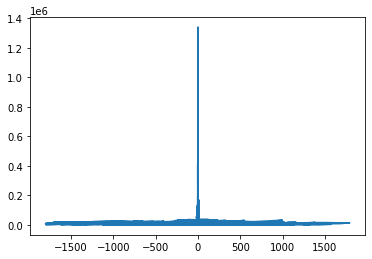

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


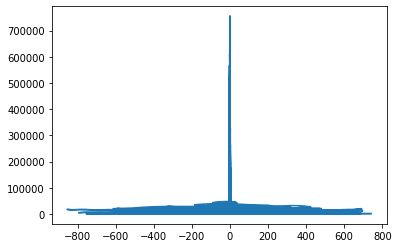

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


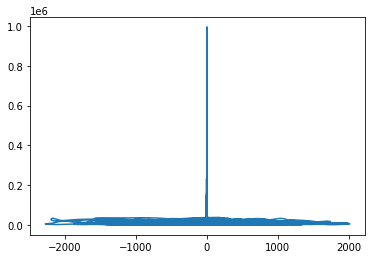

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


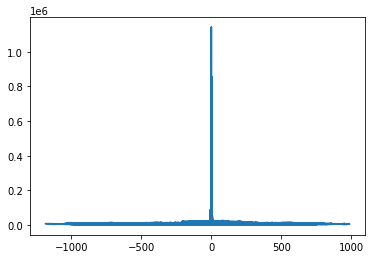

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


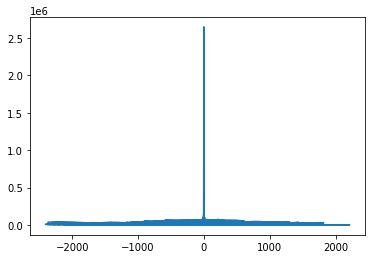

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


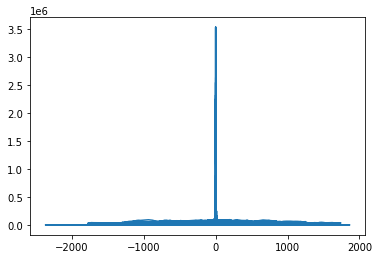

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


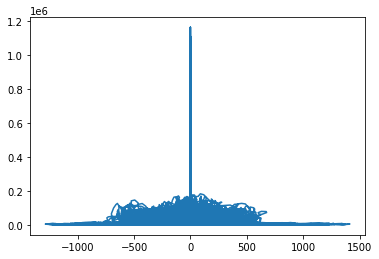

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


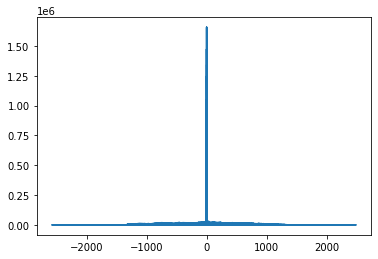

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


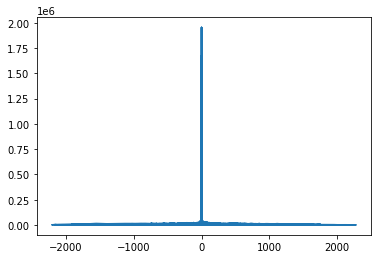

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


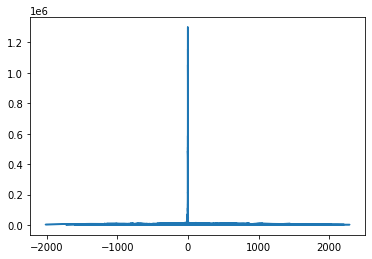

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


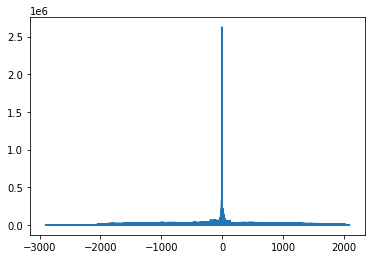

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


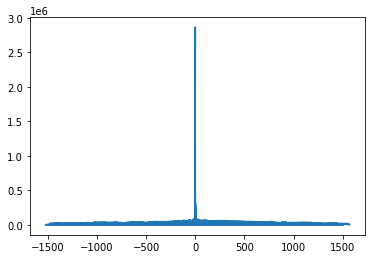

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


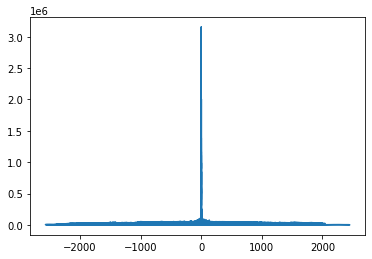

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


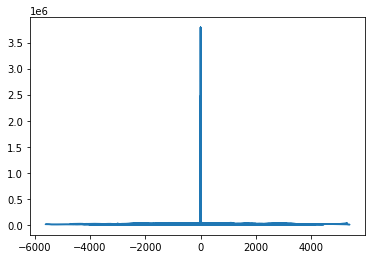

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


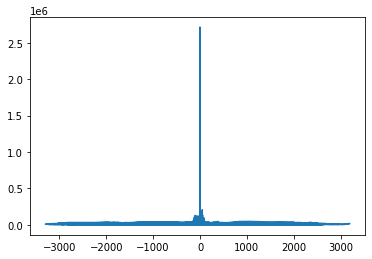

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


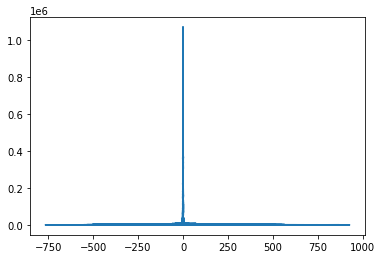

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


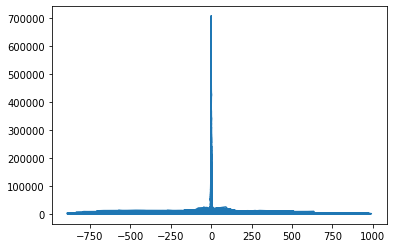

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


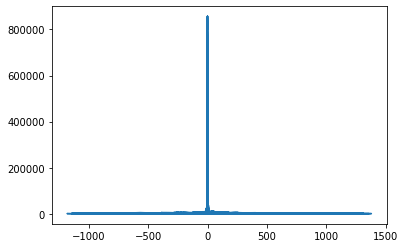

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


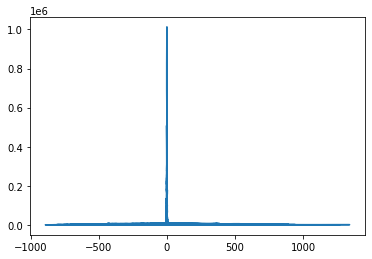

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


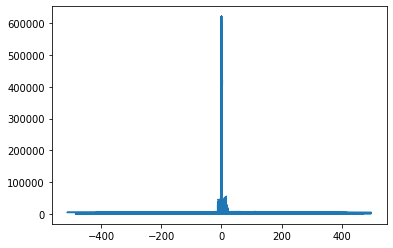

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


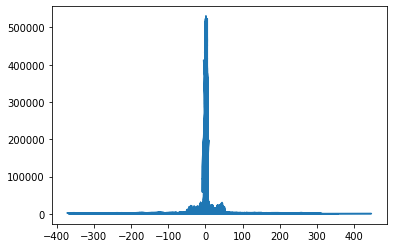

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


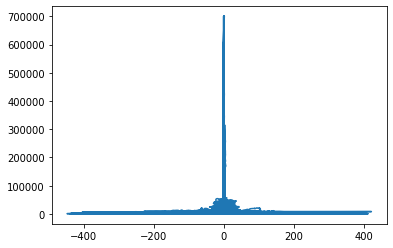

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


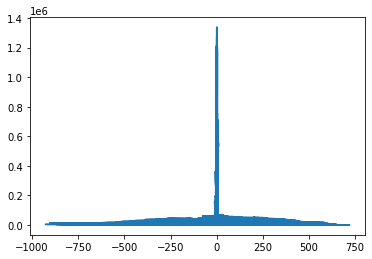

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


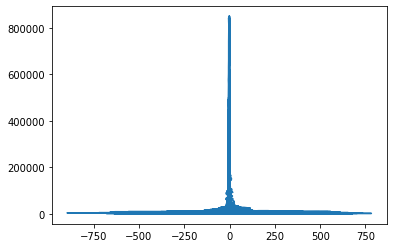

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


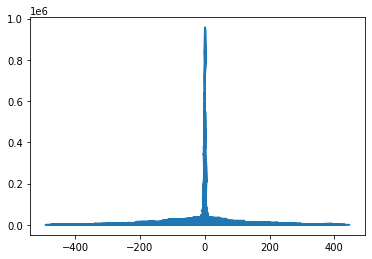

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


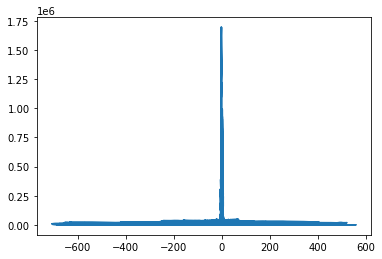

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


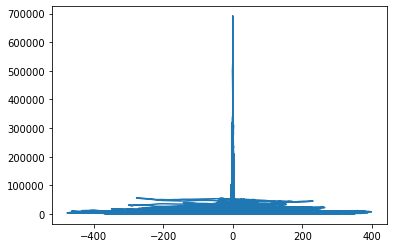

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


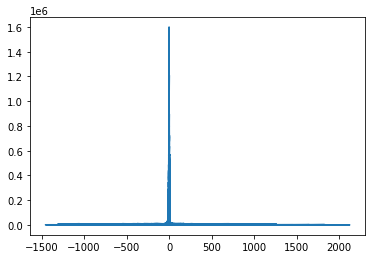

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


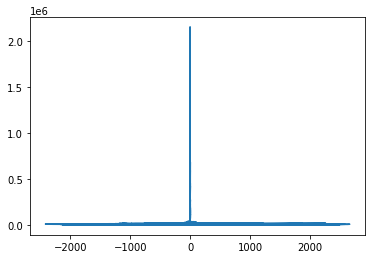

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


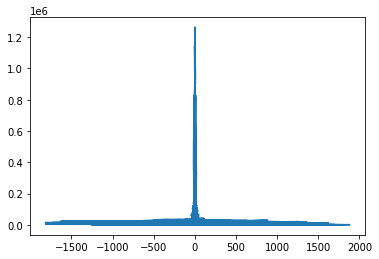

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


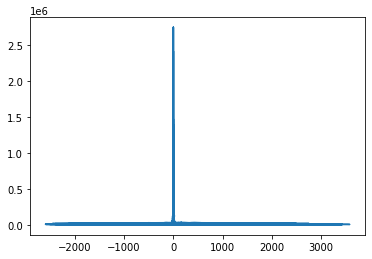

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


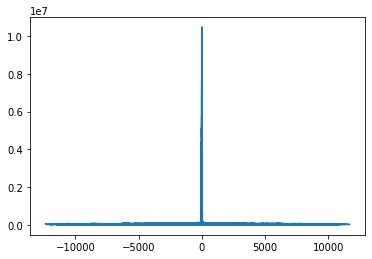

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


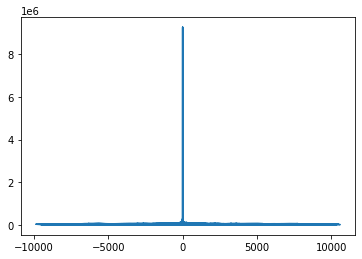

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


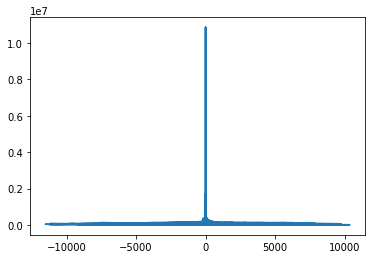

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


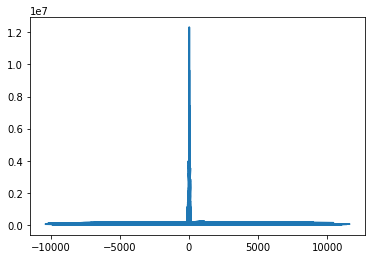

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


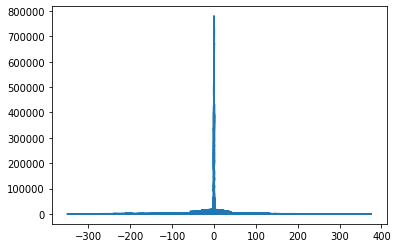

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


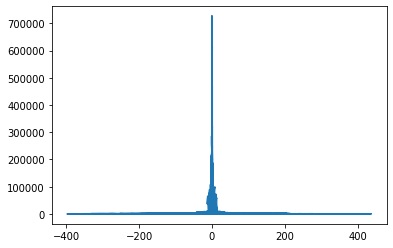

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


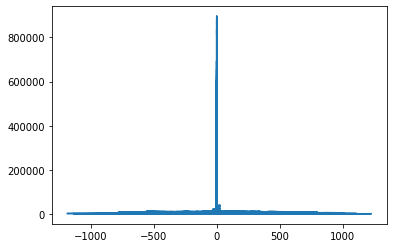

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


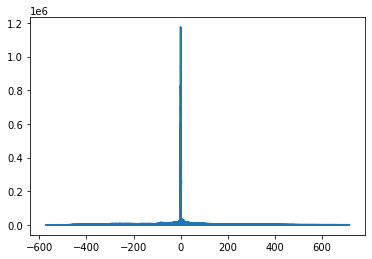

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


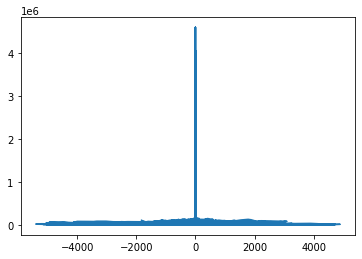

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


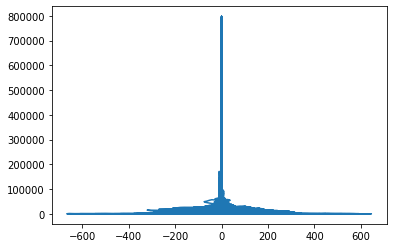

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


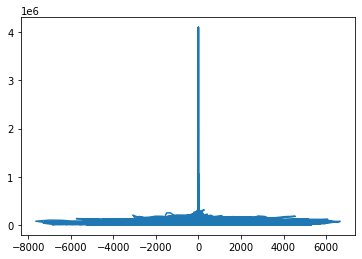

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


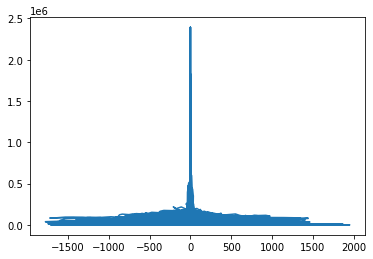

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


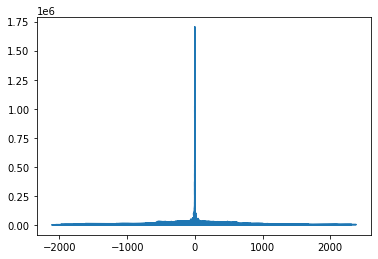

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


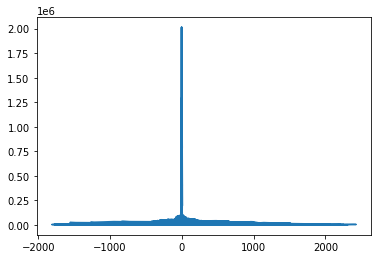

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


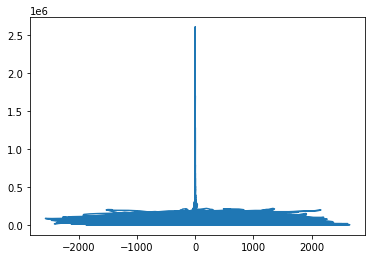

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


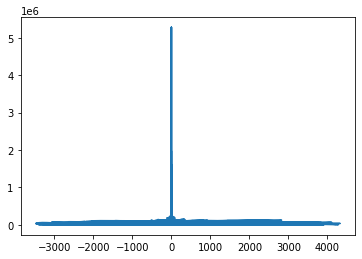

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


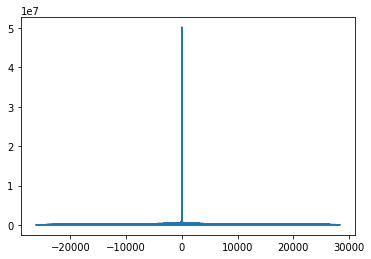

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


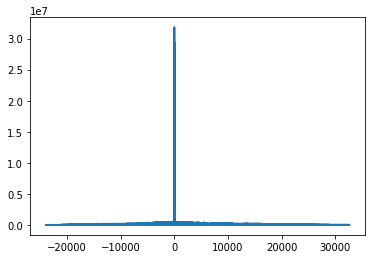

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


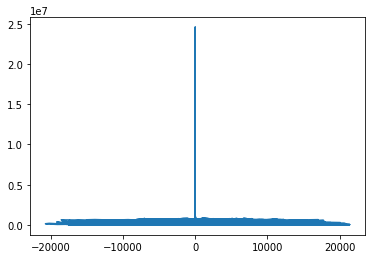

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


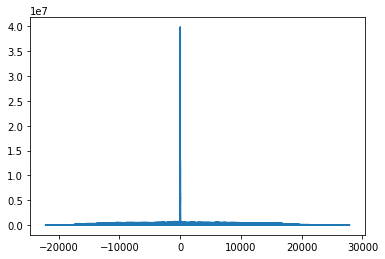

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


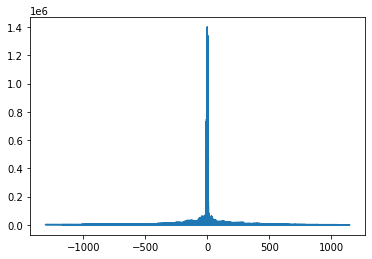

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


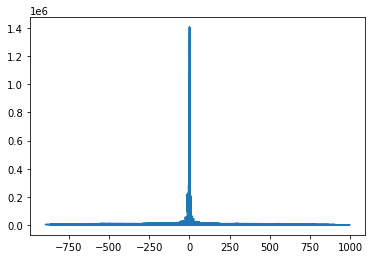

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


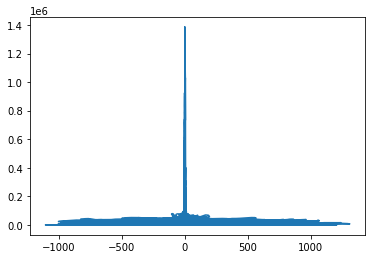

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


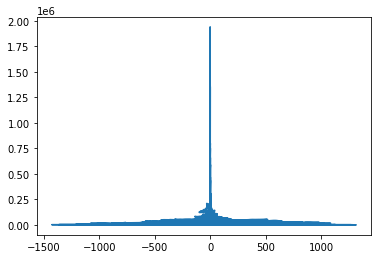

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


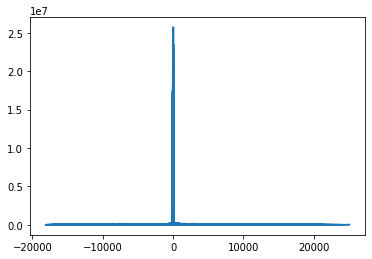

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


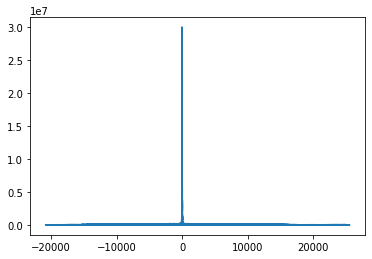

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


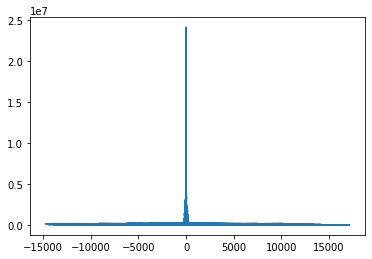

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


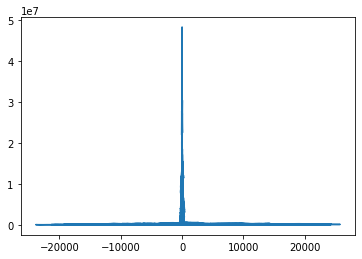

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


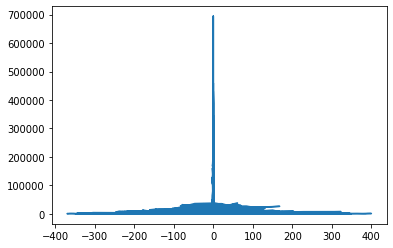

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


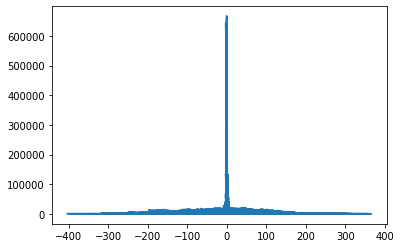

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


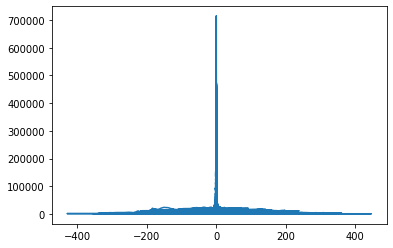

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


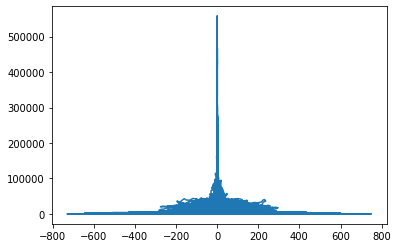

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


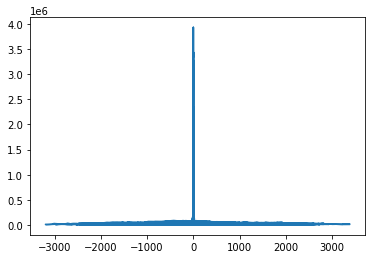

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


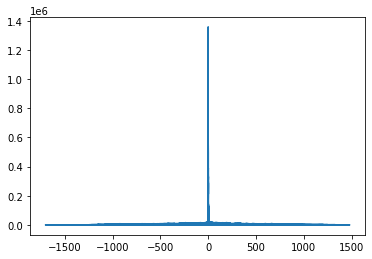

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


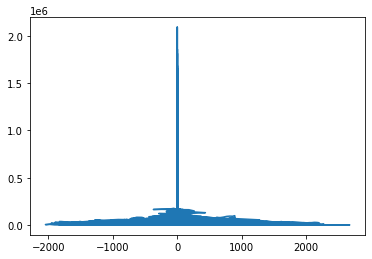

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


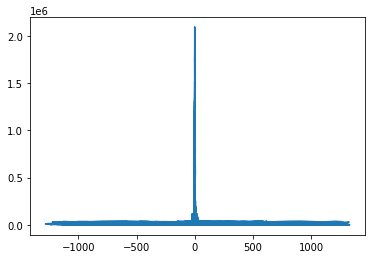

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


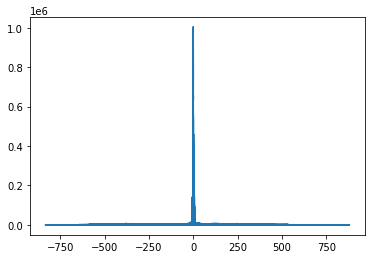

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


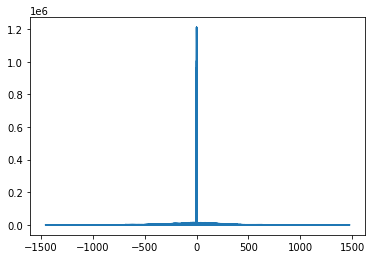

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


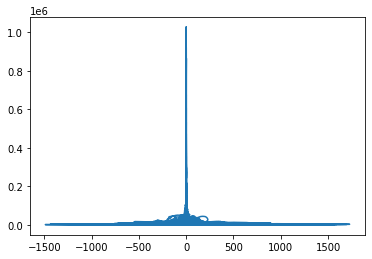

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


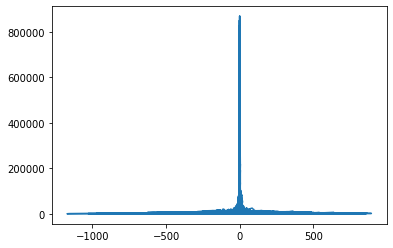

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


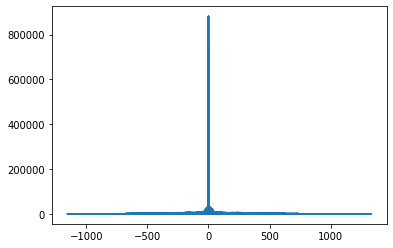

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


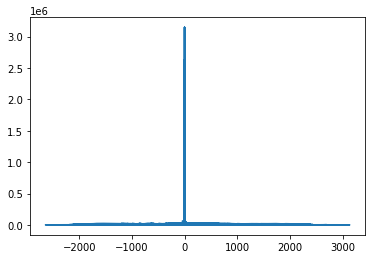

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


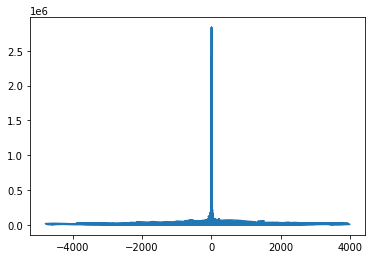

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


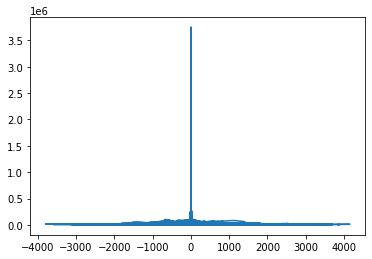

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


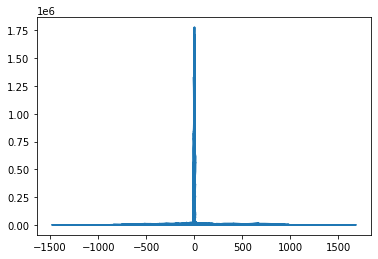

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


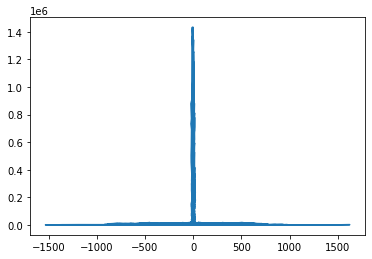

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


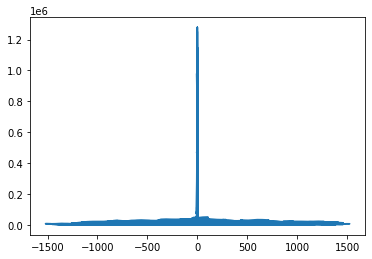

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


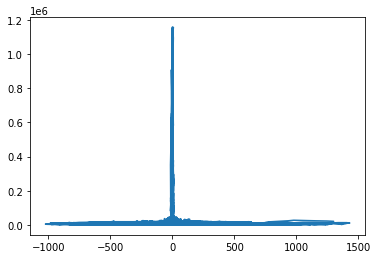

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


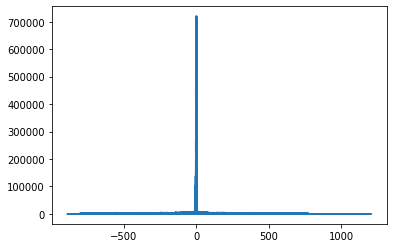

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


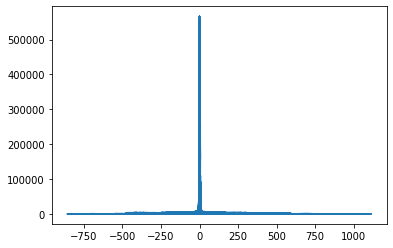

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


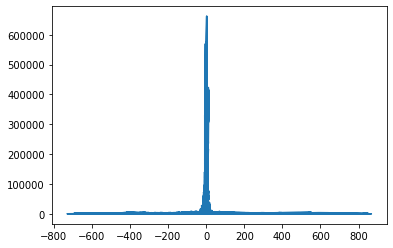

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


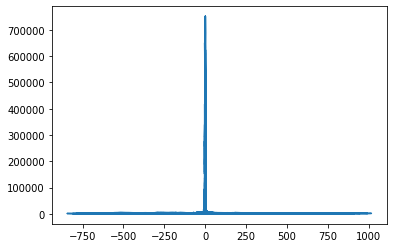

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


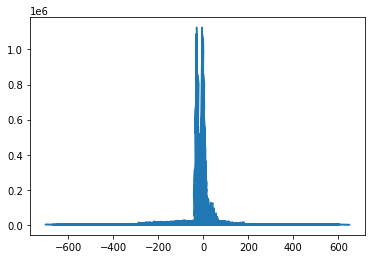

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


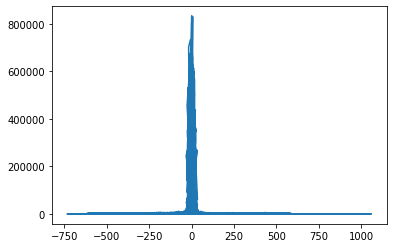

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


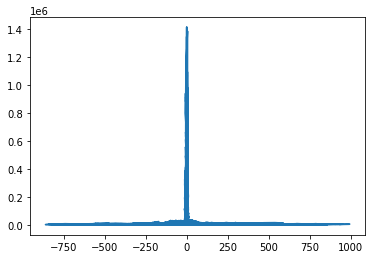

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


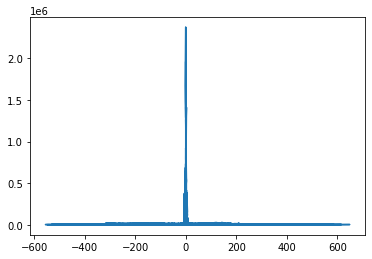

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


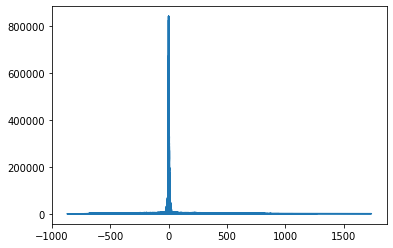

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


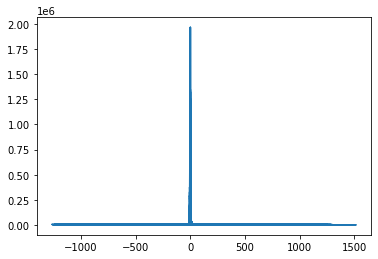

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


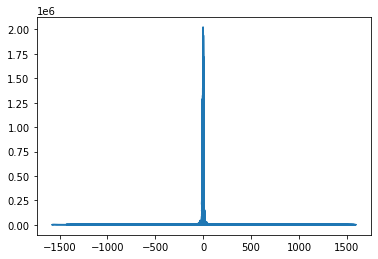

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


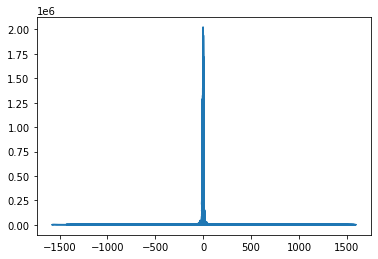

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


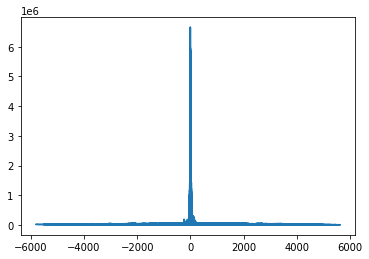

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


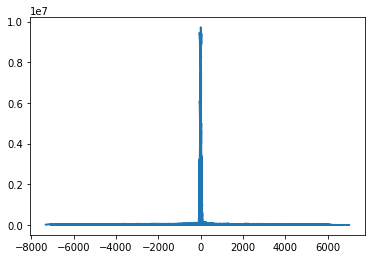

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


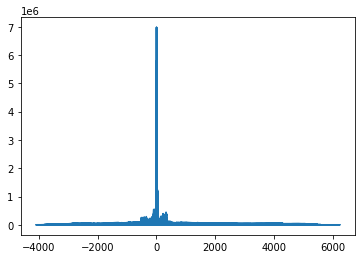

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


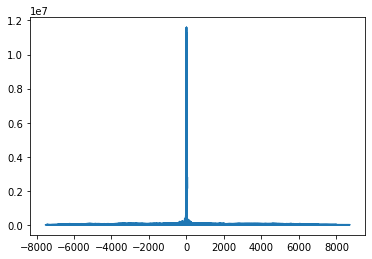

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


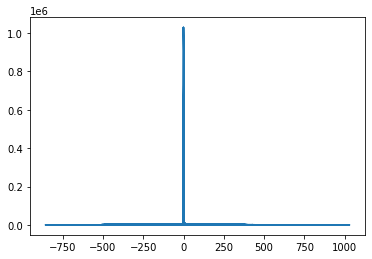

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


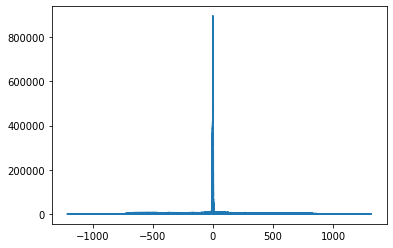

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


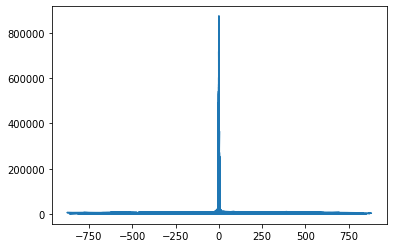

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


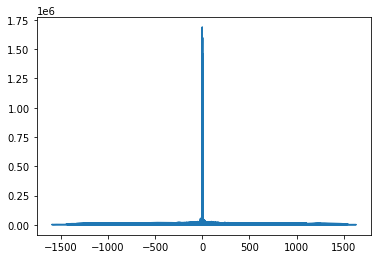

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


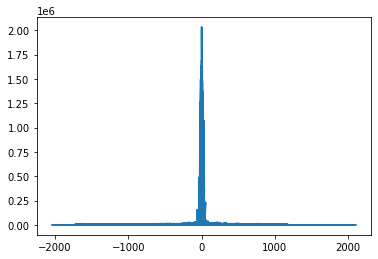

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


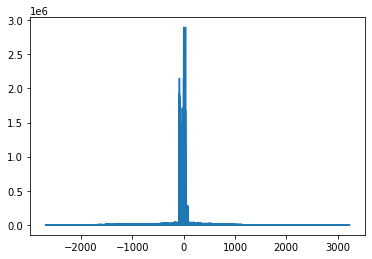

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


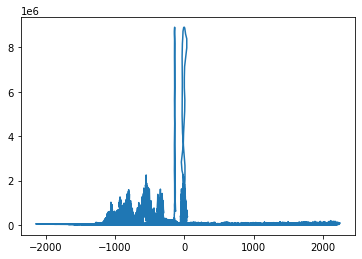

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


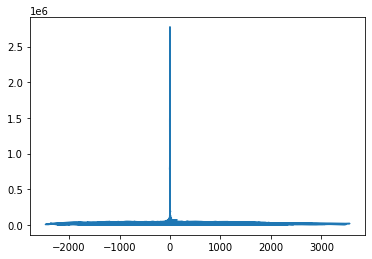

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


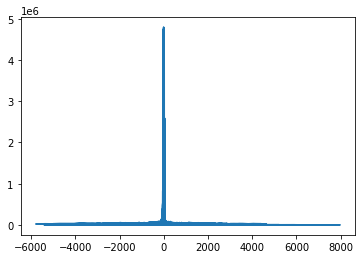

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


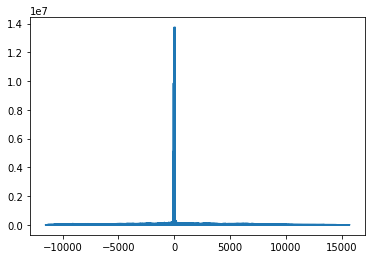

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


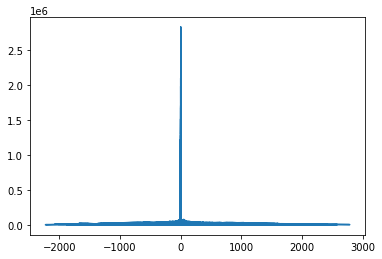

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


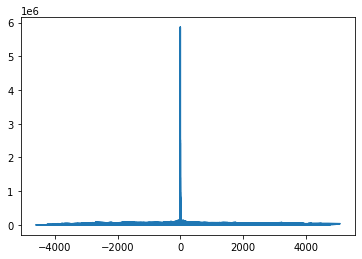

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


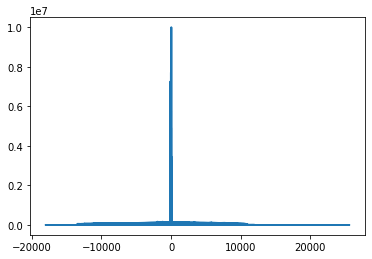

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


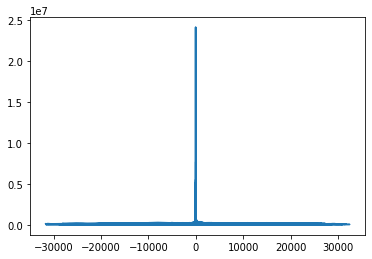

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


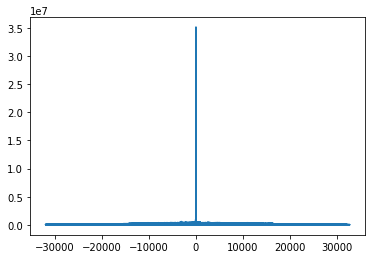

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


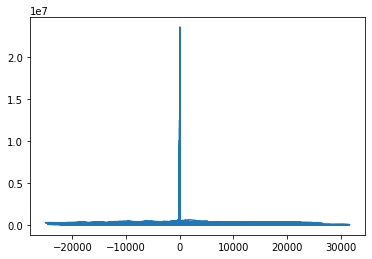

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


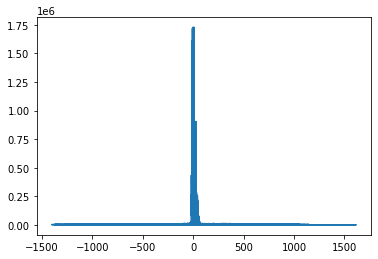

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


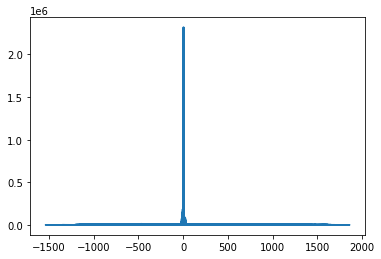

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


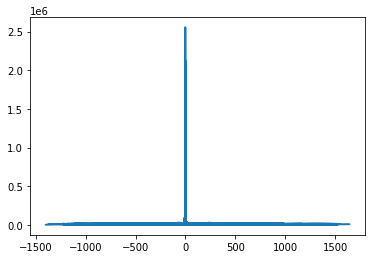

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


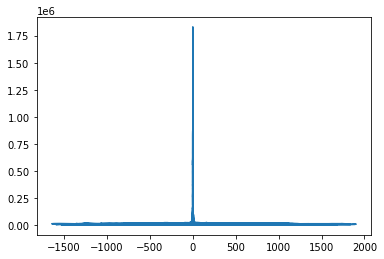

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


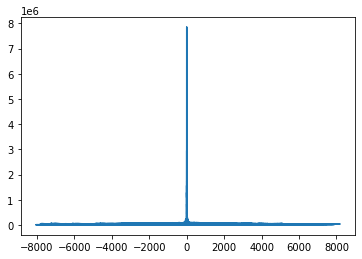

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


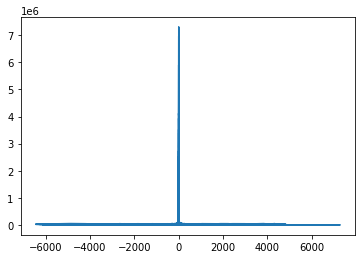

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


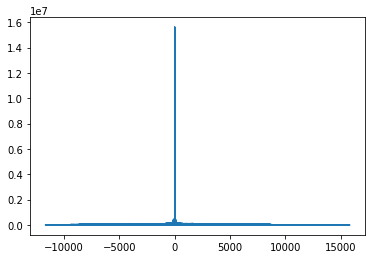

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


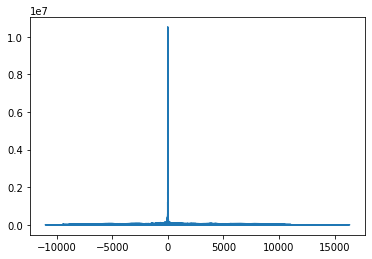

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


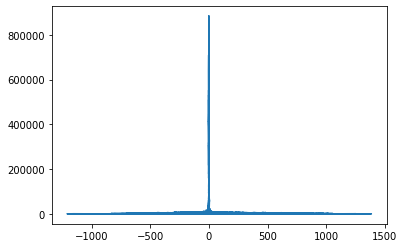

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


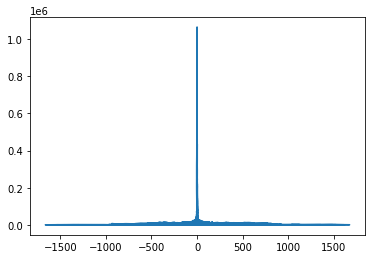

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


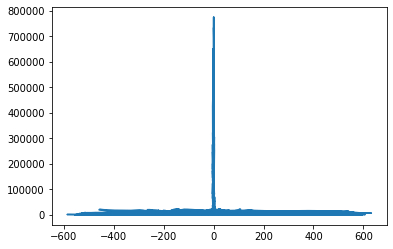

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


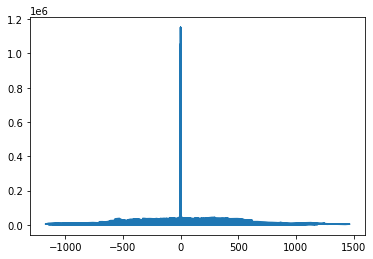

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


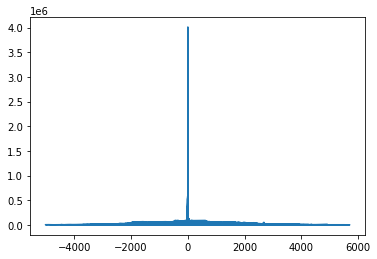

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


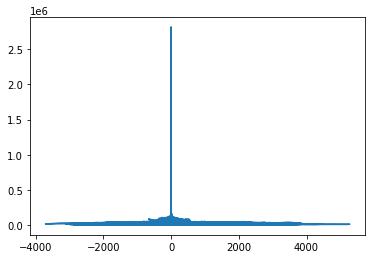

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


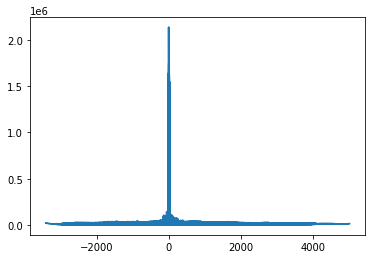

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


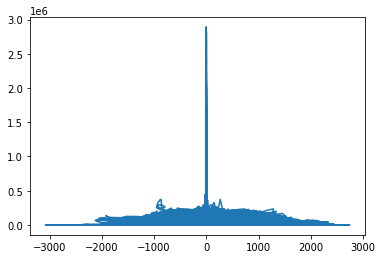

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


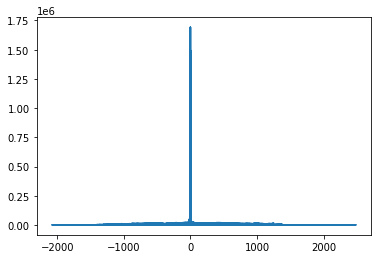

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


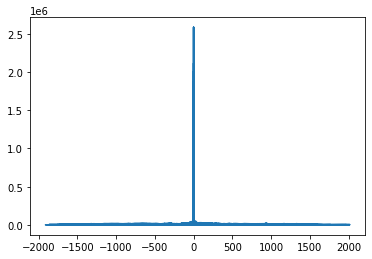

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


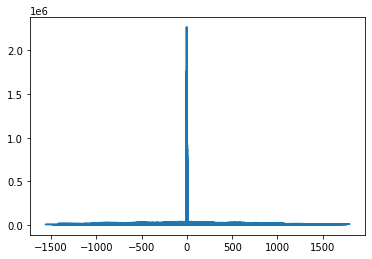

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


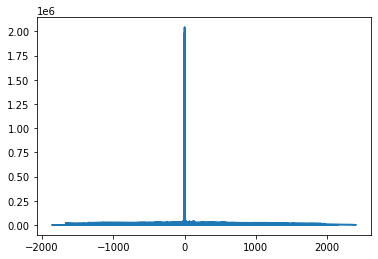

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


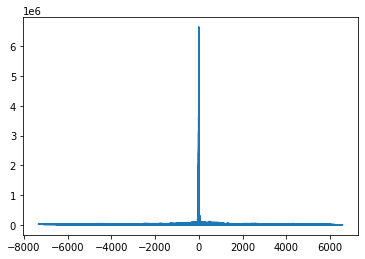

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


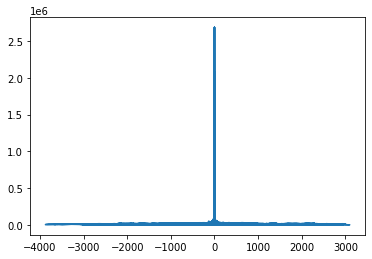

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


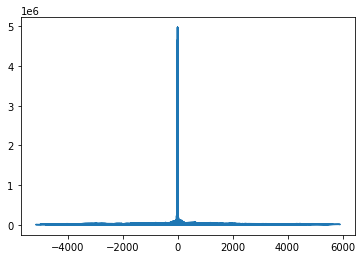

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


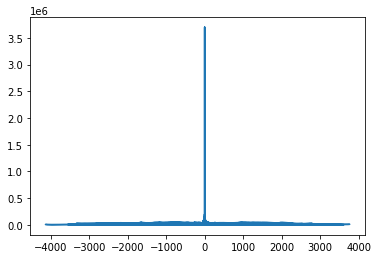

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


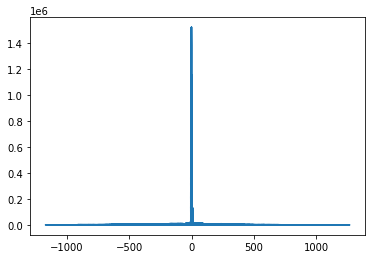

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


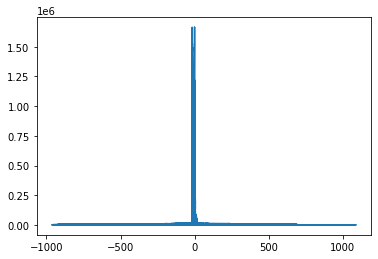

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


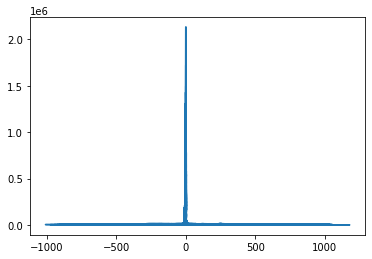

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


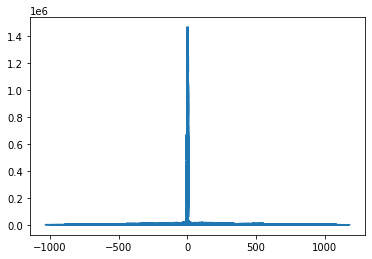

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


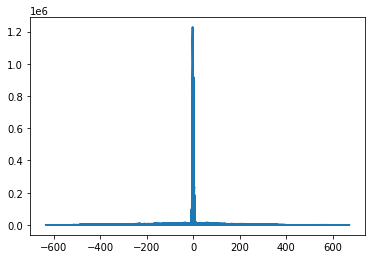

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


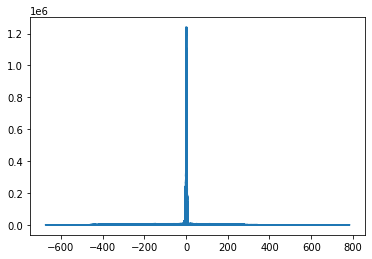

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


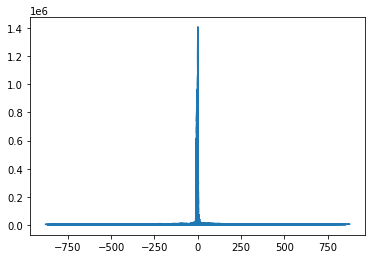

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


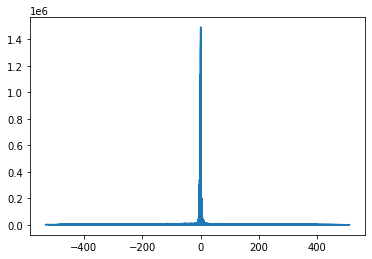

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


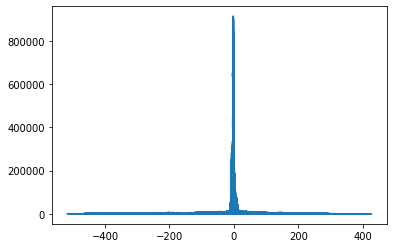

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


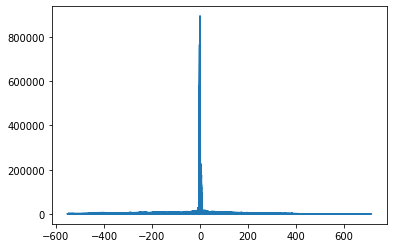

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


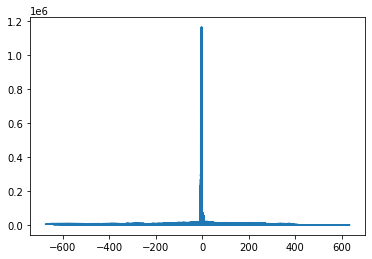

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


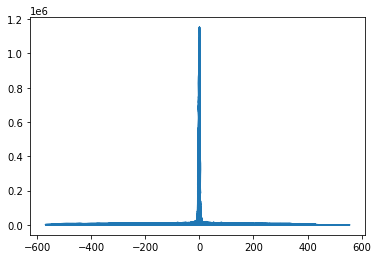

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


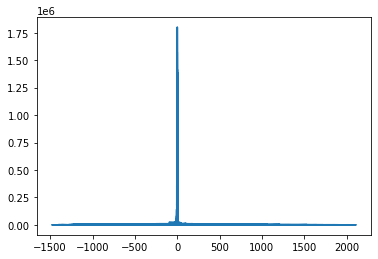

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


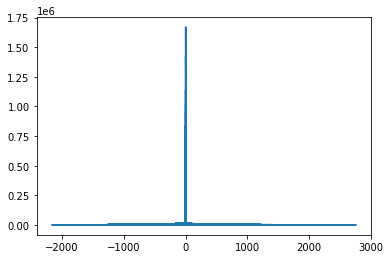

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


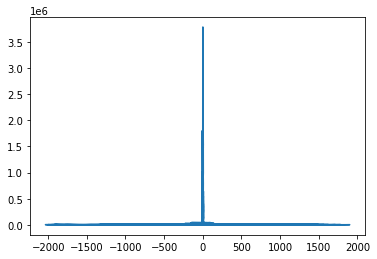

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


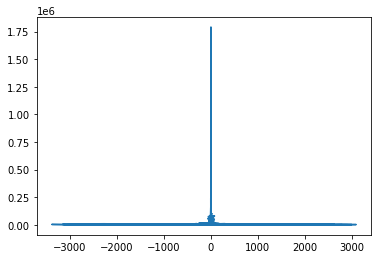

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


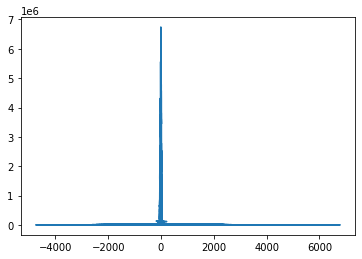

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


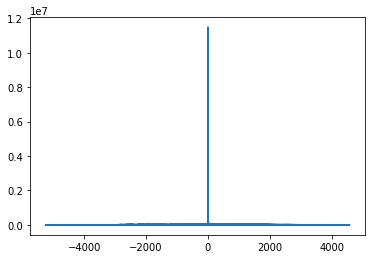

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


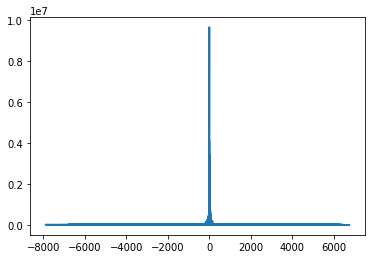

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


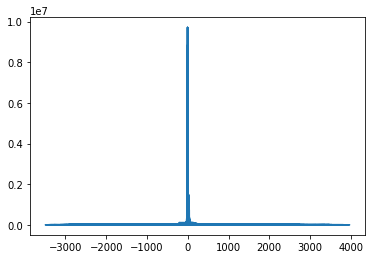

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


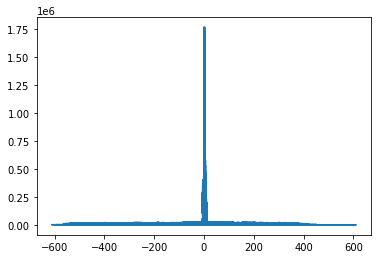

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


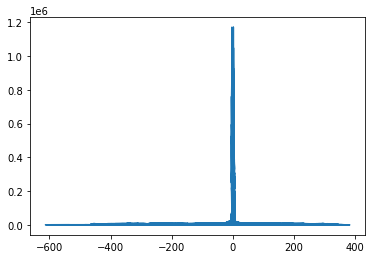

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


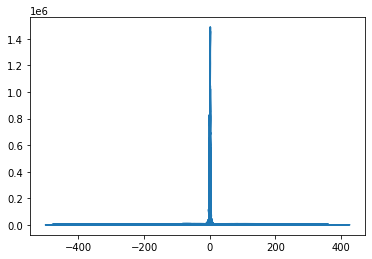

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


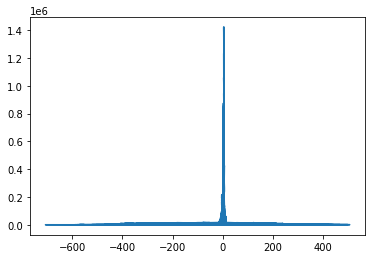

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


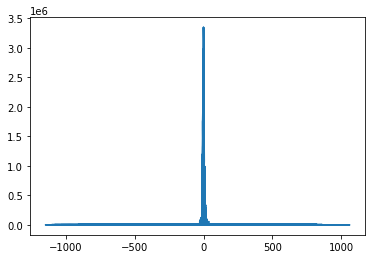

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


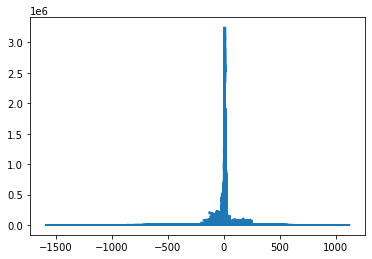

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


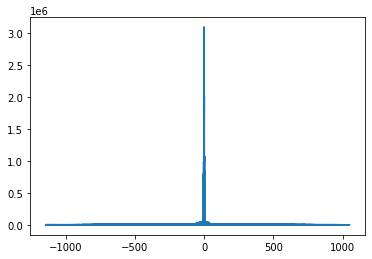

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


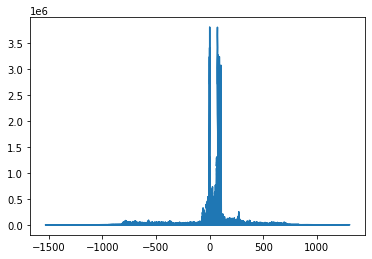

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


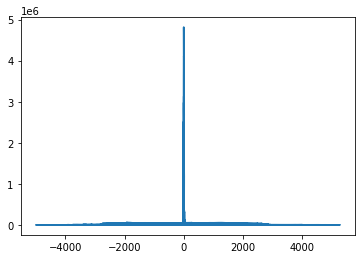

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


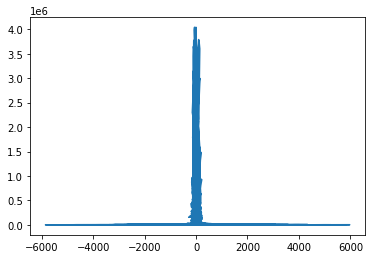

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


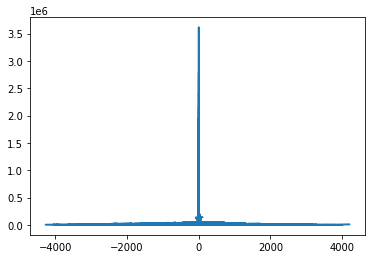

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


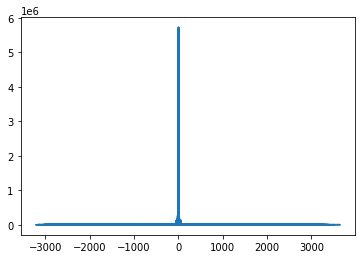

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


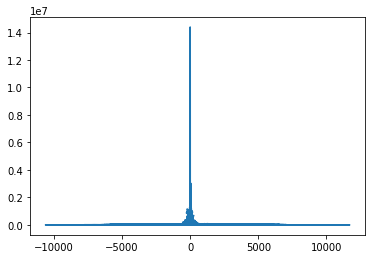

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


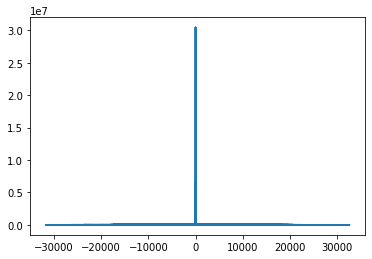

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


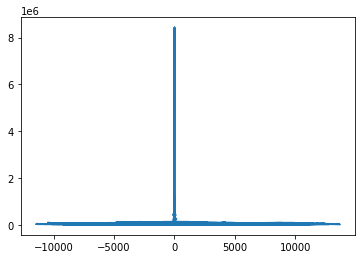

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


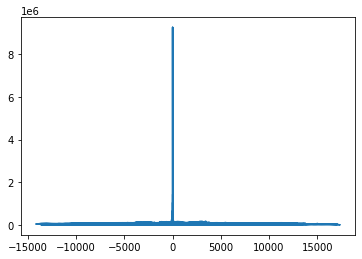

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


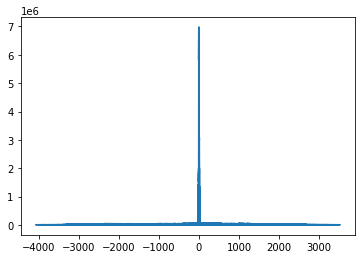

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


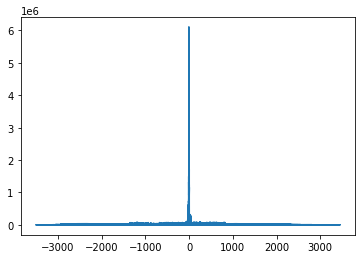

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


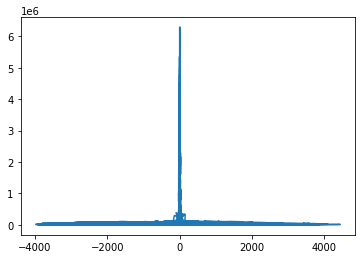

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


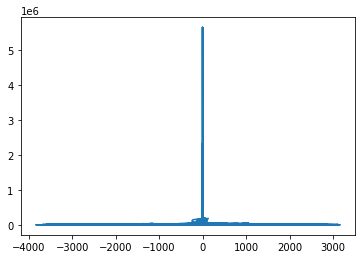

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


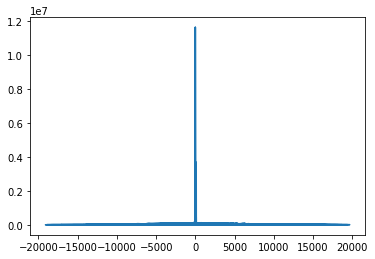

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


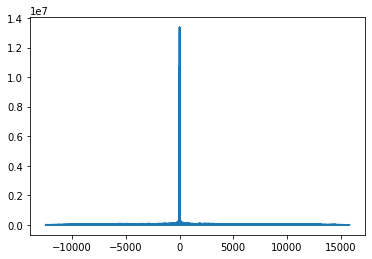

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


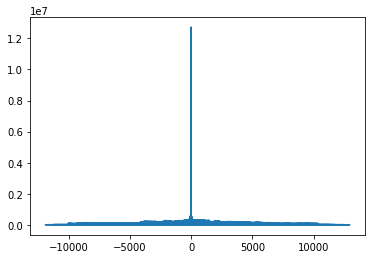

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


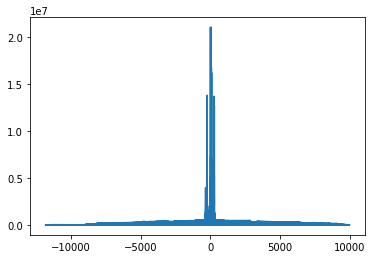

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


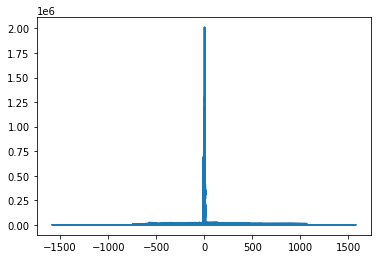

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


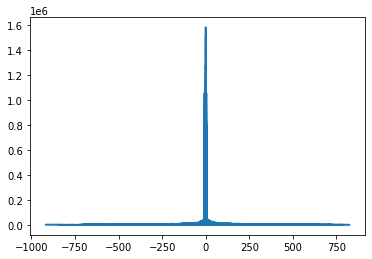

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


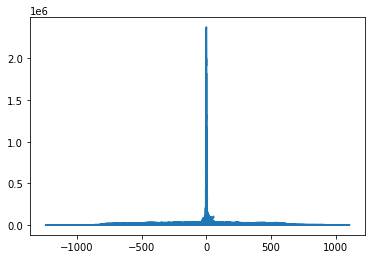

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


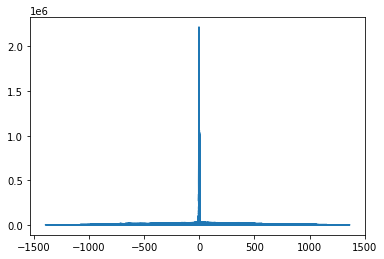

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


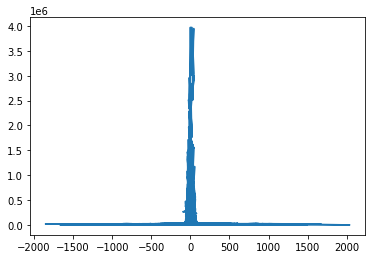

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


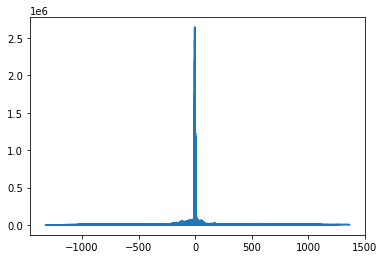

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


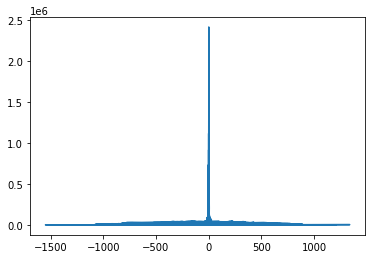

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


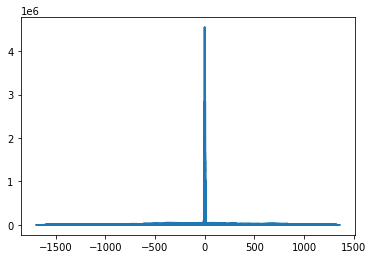

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


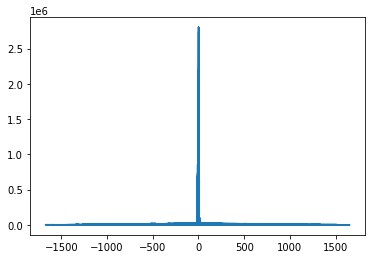

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


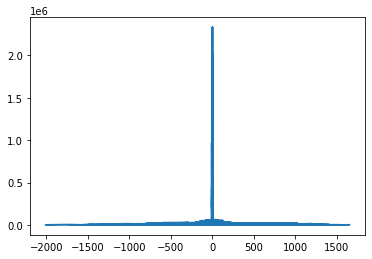

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


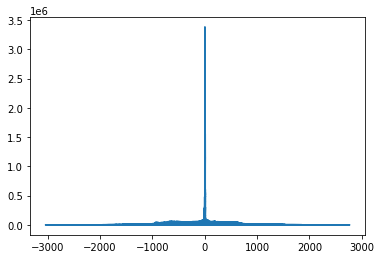

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


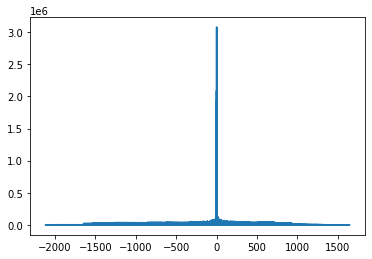

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


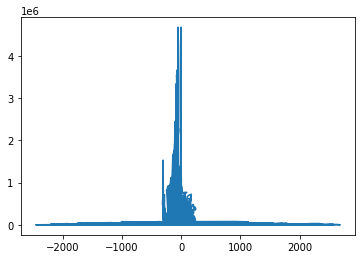

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


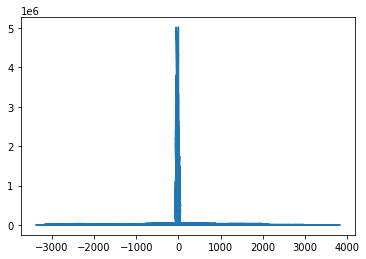

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


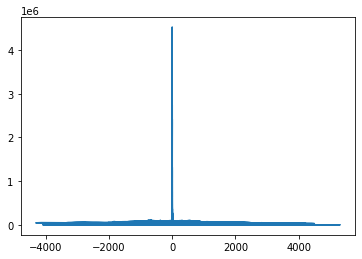

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


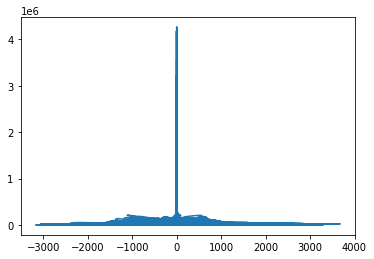

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


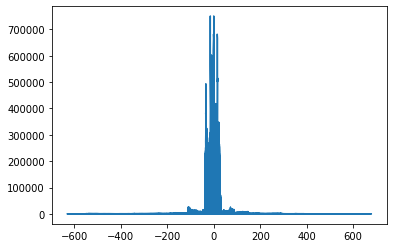

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


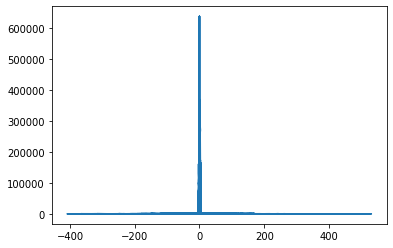

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


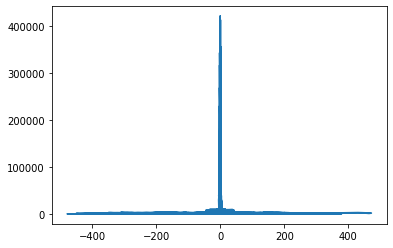

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


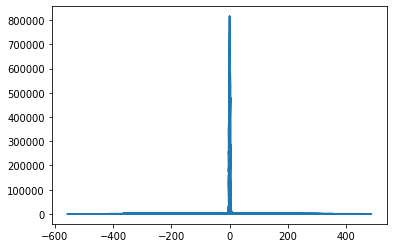

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


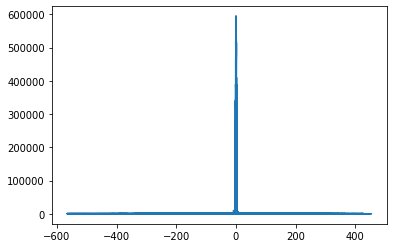

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


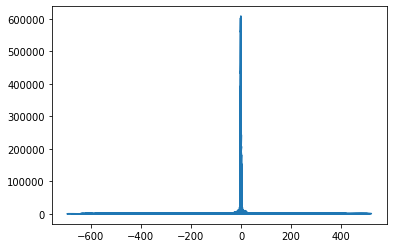

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


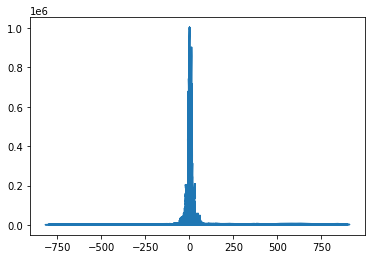

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


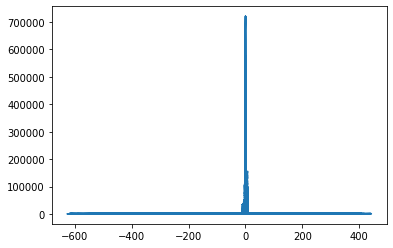

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


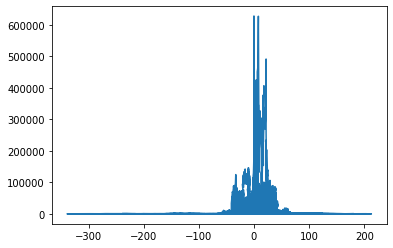

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


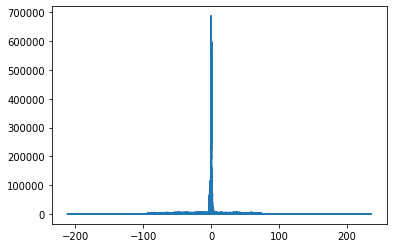

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


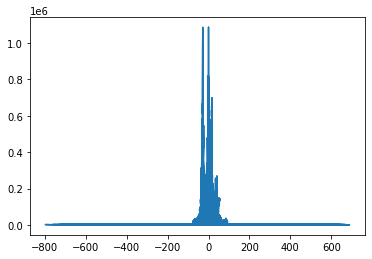

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


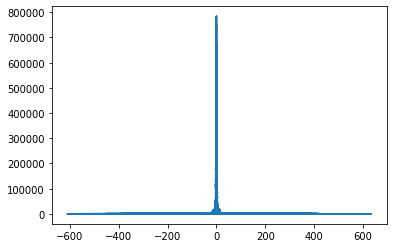

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


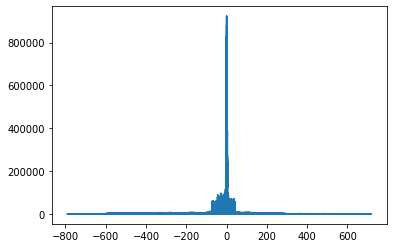

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


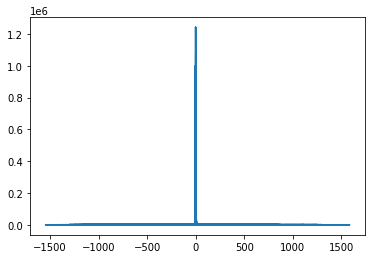

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


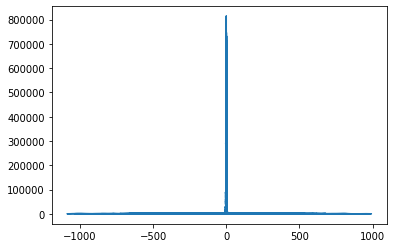

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


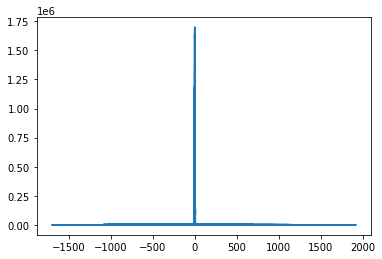

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


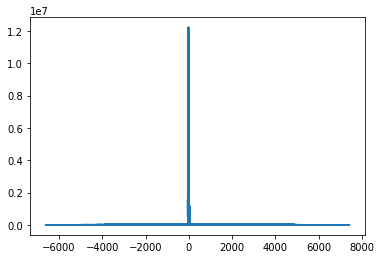

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


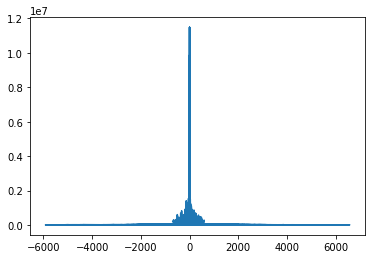

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


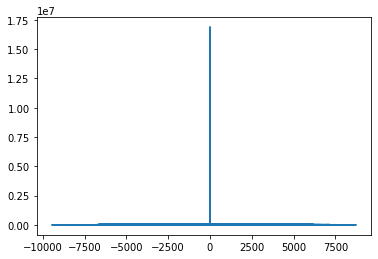

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


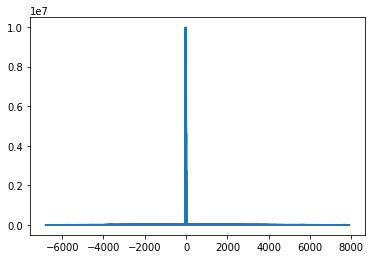

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


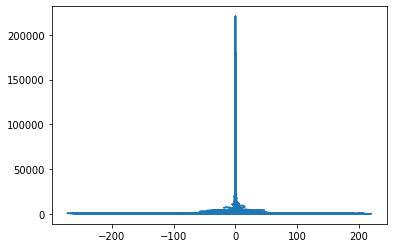

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


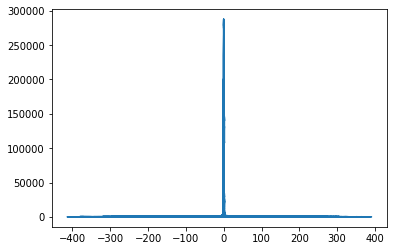

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


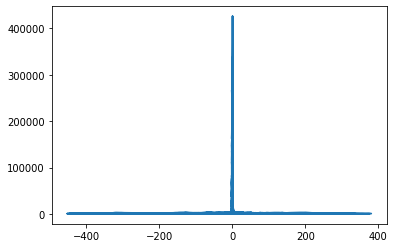

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


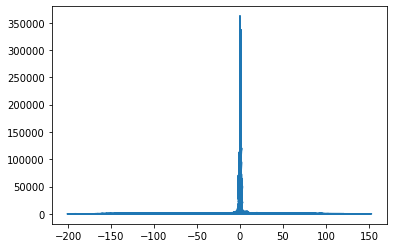

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


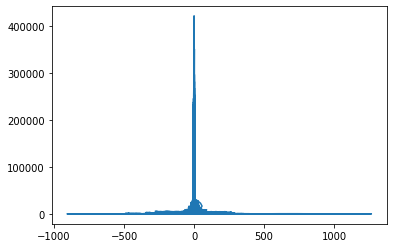

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


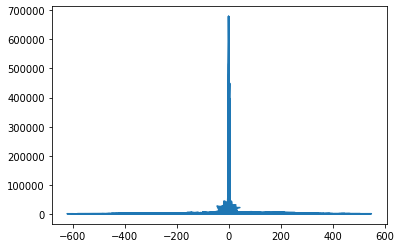

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


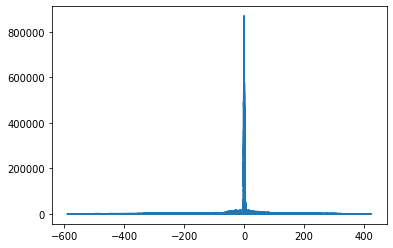

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


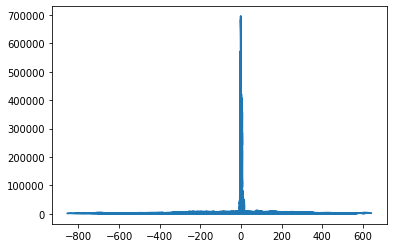

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


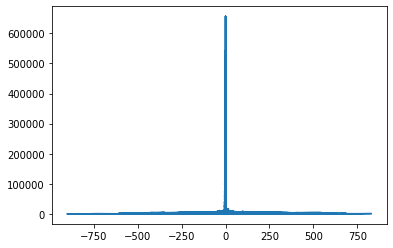

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


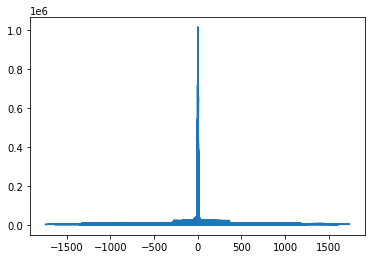

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


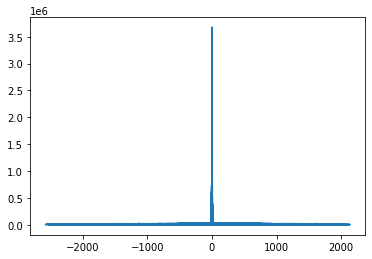

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


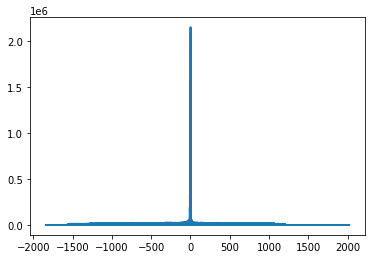

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


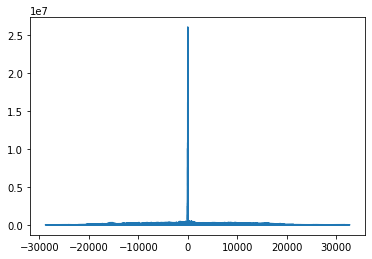

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


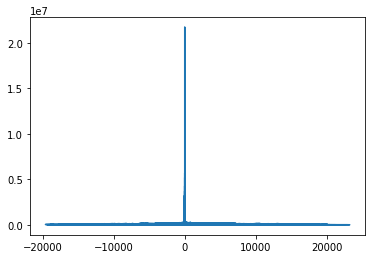

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


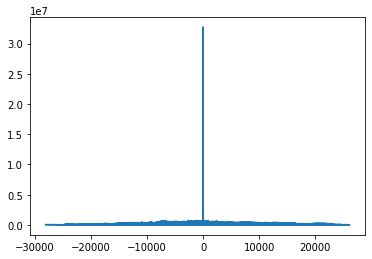

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


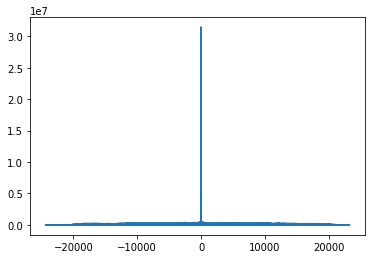

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


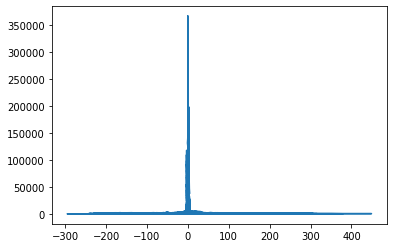

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


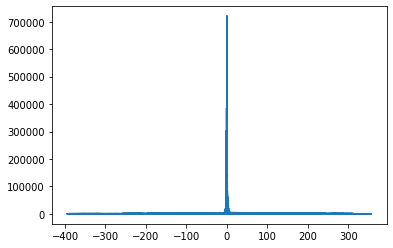

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


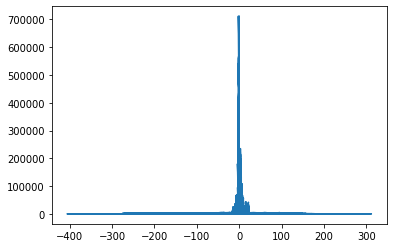

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


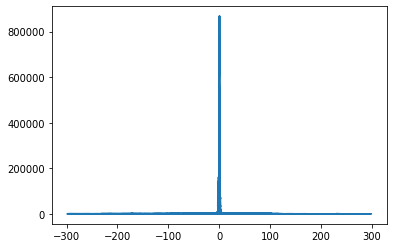

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


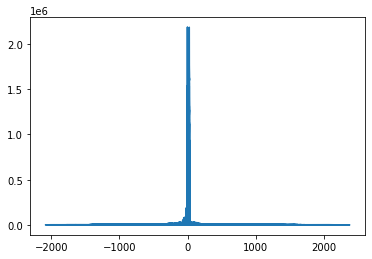

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


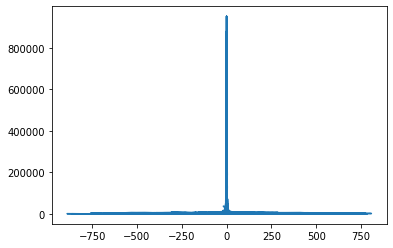

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


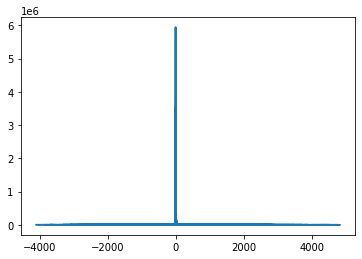

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


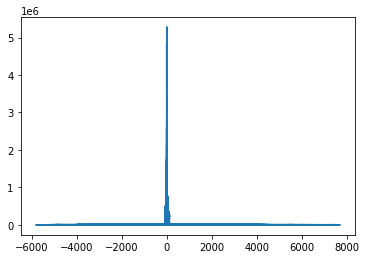

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


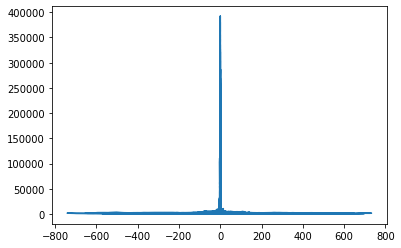

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


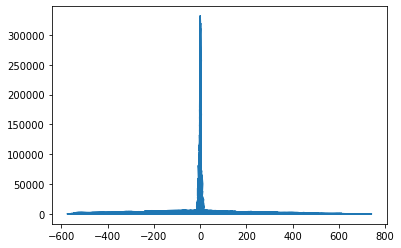

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


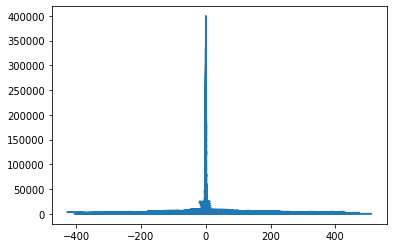

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


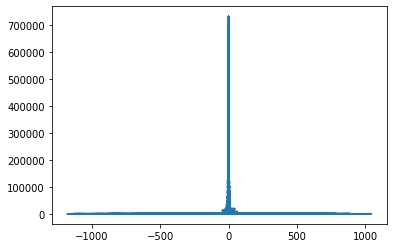

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


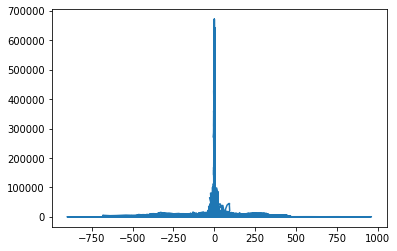

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


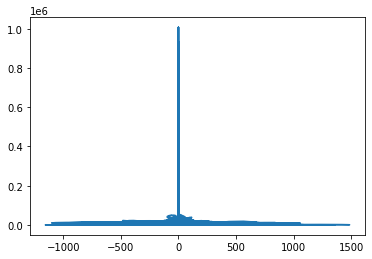

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


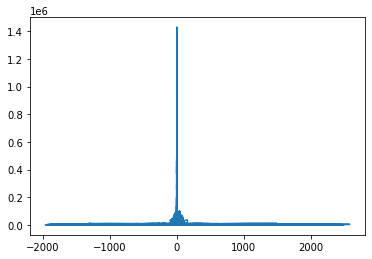

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


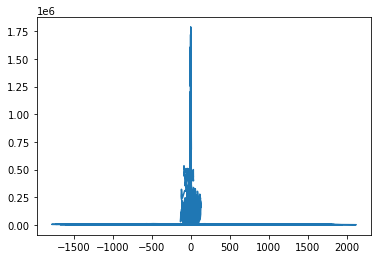

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


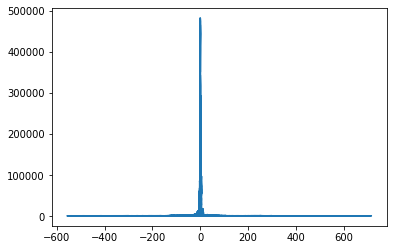

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


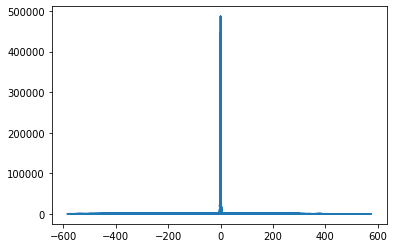

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


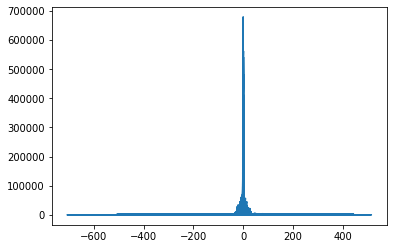

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


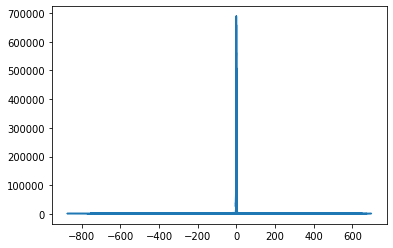

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


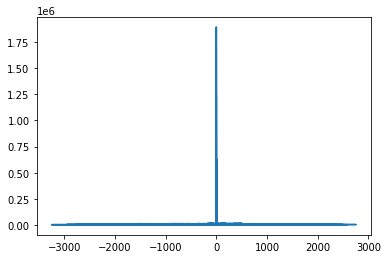

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


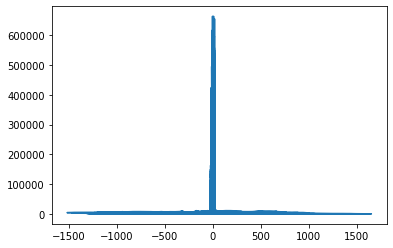

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


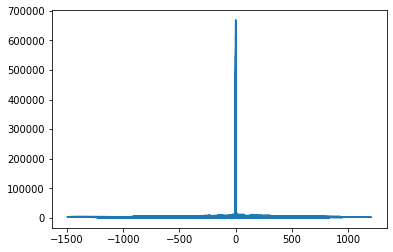

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


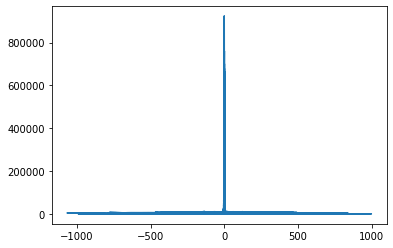

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


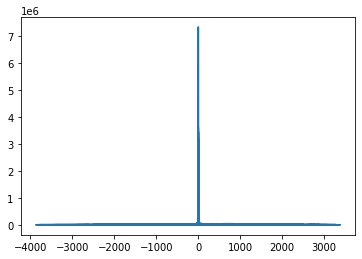

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


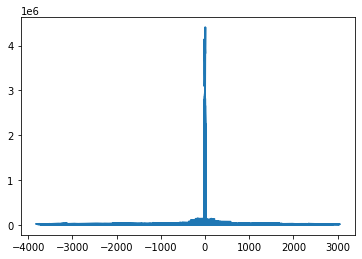

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


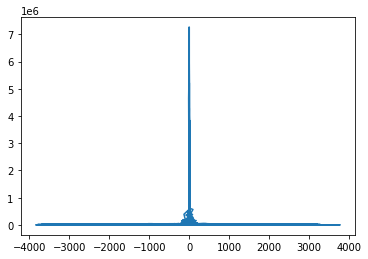

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


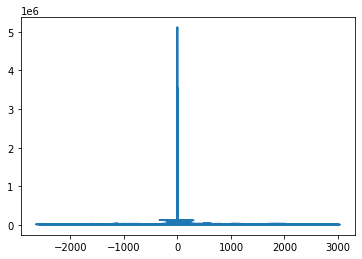

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


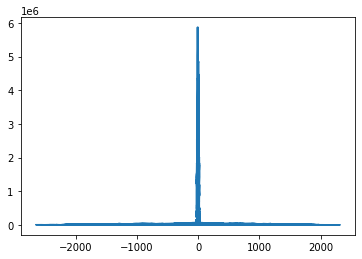

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


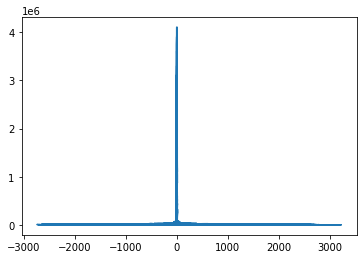

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


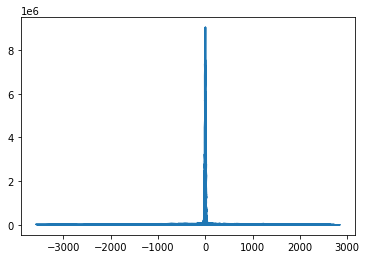

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


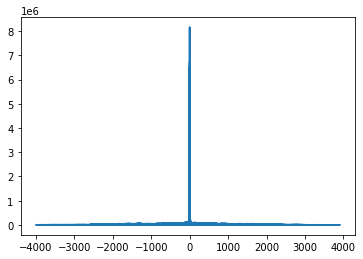

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


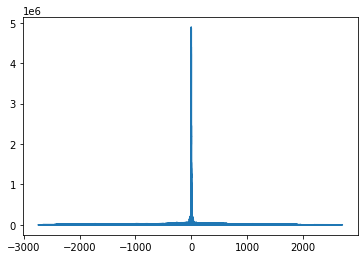

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


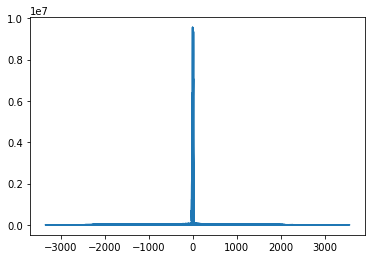

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


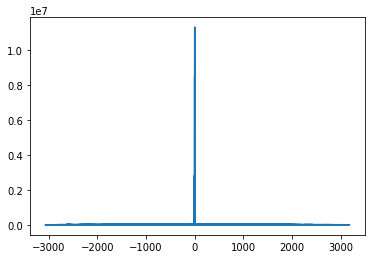

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


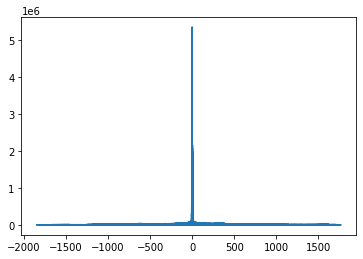

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


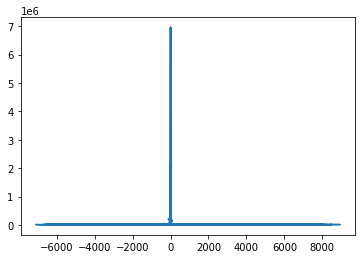

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


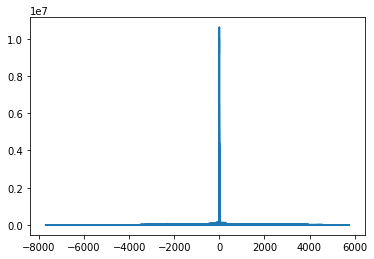

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


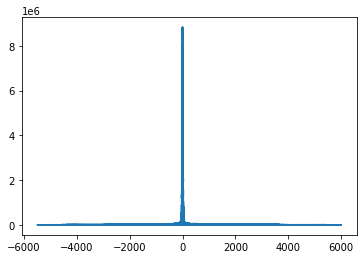

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


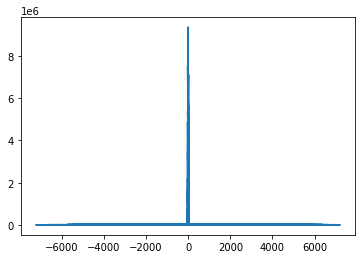

<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


<ipython-input-51-f199d0e15720>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, data = wav.read(listOfFiles[file])


In [51]:
# Here The Data Set is loaded and plots are Visualised by Calling the Plotting Functions . 
import matplotlib.pyplot as plt
from scipy.io import wavfile as wav
from scipy.fftpack import fft
import numpy as np
for file in range(0 , len(listOfFiles) , 1):
    rate, data = wav.read(listOfFiles[file])
    fft_out = fft(data)
    %matplotlib inline
    plt.plot(data, np.abs(fft_out))
    plt.show()
    
signals={}
fft={}
fbank={}
mfccs={}
# load data
for file in range(0 , len(listOfFiles) , 1):
#     rate, data = wavfile.read(listOfFiles[file])
     signal,rate =librosa.load(listOfFiles[file] , sr=44100)
     mask = envelope(signal , rate , 0.0005)
     signals[file] = signal
     fft[file] = calc_fft(signal , rate)
    
     bank = logfbank(signal[:rate] , rate , nfilt = 26, nfft = 1103).T
     fbank[file] = bank
     mel = mfcc(signal[:rate] , rate , numcep =13 , nfilt = 26 , nfft=1103).T
     mfccs[file]=mel

plot_signals(signals)
plt.show()

plot_fft(fft)
plt.show()

plot_fbank(fbank)
plt.show()

plot_mfccs(mfccs)
plt.show()

In [12]:
def envelope(y , rate, threshold):
    mask=[]
    y=pd.Series(y).apply(np.abs)
    y_mean = y.rolling(window=int(rate/10) ,  min_periods=1 , center = True).mean()
    for mean in y_mean:
        if mean>threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask

In [14]:
#The clean Audio Files are redirected to Clean Audio Folder Directory 
import glob,pickle
for file in tqdm(glob.glob(r'D:\all\Drishti\Speech Emotion Recognition\speech-emotion-recognition-ravdess-data\\**\\*.wav')):
    file_name = os.path.basename(file)
    signal , rate = librosa.load(file, sr=16000)
    mask = envelope(signal,rate, 0.0005)
    wavfile.write(filename= r'D:\all\Drishti\Speech Emotion Recognition\clean_speech\\'+str(file_name), rate=rate,data=signal[mask])

100%|██████████| 1440/1440 [03:21<00:00,  7.16it/s]


In [15]:
#Feature Extraction of Audio Files Function 
#Extract features (mfcc, chroma, mel) from a sound file
def extract_feature(file_name, mfcc, chroma, mel):
    with soundfile.SoundFile(file_name) as sound_file:
        X = sound_file.read(dtype="float32")
        sample_rate=sound_file.samplerate
        if chroma:
            stft=np.abs(librosa.stft(X))
        result=np.array([])
        if mfcc:
            mfccs=np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=40).T, axis=0)
        result=np.hstack((result, mfccs))
        if chroma:
            chroma=np.mean(librosa.feature.chroma_stft(S=stft, sr=sample_rate).T,axis=0)
        result=np.hstack((result, chroma))
        if mel:
            mel=np.mean(librosa.feature.melspectrogram(X, sr=sample_rate).T,axis=0)
        result=np.hstack((result, mel))
    return result

In [87]:
#Emotions in the RAVDESS dataset to be classified Audio Files based on . 
emotions={
  '01':'neutral',
  '02':'calm',
  '03':'happy',
  '04':'sad',
  '05':'angry',
  '06':'fearful',
  '07':'disgust',
  '08':'surprised'
}
#These are the emotions User wants to observe more :
observed_emotions=['calm', 'happy', 'fearful', 'disgust']

In [38]:

'''def extract_feature(file_name, mfcc, chroma, mel):
    X, sample_rate = librosa.load(file_name)
    features = []
    if mfcc:
        mfccs = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=40)
        mfccs = np.mean(mfccs.T, axis=0)
        features.append(mfccs)
    if chroma:
        stft = np.abs(librosa.stft(X))
        chroma = librosa.feature.chroma_stft(S=stft, sr=sample_rate)
        chroma = np.mean(chroma.T, axis=0)
        features.append(chroma)
    if mel:
        melspec = librosa.feature.melspectrogram(y=X, sr=sample_rate)
        mel = np.mean(librosa.power_to_db(melspec).T, axis=0)
        features.append(mel)
    return np.hstack(features)'''

In [88]:
#Load the data and extract features for each sound file
from glob import glob
import os
import glob
def load_data(test_size=0.33):
    x,y=[],[]
    #answer = 0
    for file in glob.glob(r'D:\all\Drishti\Speech Emotion Recognition\clean_speech\\*.wav'):
        file_name=os.path.basename(file)
        emotion=emotions[file_name.split("-")[2]]
        if emotion not in observed_emotions:
            #answer += 1
            continue
        feature=extract_feature(file, mfcc=True, chroma=True, mel=True)
        x.append(feature)
        y.append([emotion,file_name])
    return train_test_split(np.array(x), y, test_size=test_size, random_state=9)

In [89]:
#Split the dataset
import librosa
import numpy as np
x_train,x_test,y_train,y_test=load_data(test_size=0.25)
print(np.shape(x_train),np.shape(x_test), np.shape(y_train),np.shape(y_test))
y_test_map = np.array(y_test).T
y_test = y_test_map[1]
test_filename = y_test_map[1]
y_train_map = np.array(y_train).T
y_train = y_train_map[1]
train_filename = y_train_map[1]
print(np.shape(y_train),np.shape(y_test))
print(*test_filename,sep="\n")

(576, 180) (192, 180) (576, 2) (192, 2)
(576,) (192,)
03-01-06-01-02-02-01.wav
03-01-03-01-02-01-21.wav
03-01-07-01-02-02-04.wav
03-01-02-02-01-02-24.wav
03-01-07-01-02-02-19.wav
03-01-06-01-01-01-07.wav
03-01-07-01-01-01-16.wav
03-01-02-01-02-02-06.wav
03-01-06-01-01-02-07.wav
03-01-06-02-01-01-15.wav
03-01-02-02-02-02-07.wav
03-01-06-01-02-02-19.wav
03-01-06-02-02-02-05.wav
03-01-06-01-01-01-14.wav
03-01-06-01-02-01-15.wav
03-01-03-02-02-01-06.wav
03-01-02-01-01-02-16.wav
03-01-07-01-01-01-13.wav
03-01-03-02-02-02-24.wav
03-01-02-01-02-02-19.wav
03-01-02-02-01-02-09.wav
03-01-02-01-01-02-07.wav
03-01-03-01-02-01-13.wav
03-01-02-01-02-01-18.wav
03-01-02-02-02-02-03.wav
03-01-02-02-01-01-11.wav
03-01-03-01-02-02-20.wav
03-01-03-02-01-02-06.wav
03-01-06-01-01-02-11.wav
03-01-03-01-02-01-18.wav
03-01-06-01-01-01-15.wav
03-01-07-02-01-02-08.wav
03-01-07-02-01-02-23.wav
03-01-03-01-02-02-10.wav
03-01-06-01-01-01-23.wav
03-01-07-02-02-01-18.wav
03-01-06-02-02-01-22.wav
03-01-07-02-01-01-21.

In [90]:
#Get the shape of the training and testing datasets
# print((x_train.shape[0], x_test.shape[0]))
print((x_train[0], x_test[0]))
#Get the number of features extracted
print(f'Features extracted: {x_train.shape[1]}')

(array([-5.14122864e+02,  1.03149635e+02, -2.52301559e+01,  5.09672508e+01,
       -2.73862247e+01,  6.01213217e+00, -2.05949001e+01,  7.06641054e+00,
       -1.08632669e+01,  2.81318641e+00,  7.54137707e+00, -1.94297445e+00,
        1.80253759e-01, -7.04563856e+00,  8.65320110e+00, -1.08649397e+01,
        2.73779678e+00, -6.57869244e+00, -5.16682565e-01, -2.52820849e+00,
       -5.53812313e+00, -3.99278712e+00, -6.16455460e+00,  9.40563619e-01,
       -7.84867144e+00,  2.84634519e+00, -9.37721443e+00, -3.43395144e-01,
        2.35371351e+00, -2.14530230e+00,  1.03663516e+00, -3.03826284e+00,
       -4.38508123e-01, -1.58982408e+00,  2.22326183e+00, -5.29329300e+00,
       -2.87983942e+00, -6.35665607e+00, -5.84168768e+00, -1.98998523e+00,
        6.20925307e-01,  6.11043751e-01,  6.66240752e-01,  6.77551746e-01,
        7.23964870e-01,  7.46001720e-01,  6.91369355e-01,  6.59216106e-01,
        7.25267768e-01,  6.77480221e-01,  6.25627697e-01,  6.34911716e-01,
       -4.09653435e+01, 

In [91]:
# Initialize the Multi Layer Perceptron Classifier
model=MLPClassifier(alpha=0.01, batch_size=256, epsilon=1e-08, hidden_layer_sizes=(300,), learning_rate='adaptive', max_iter=500)

In [92]:
# Train the model 
model.fit(x_train, y_train)

MLPClassifier(alpha=0.01, batch_size=256, hidden_layer_sizes=(300,),
              learning_rate='adaptive', max_iter=500)

In [93]:
# SAVING THE MODEL
import pickle
#Save the Modle to file in the current working directory
#For any new testing data than the data in dataset

Pkl_Filename = "Emotion_Voice_Detection_Model.pkl"

with open(Pkl_Filename, 'wb') as file:
    pickle.dump(model, file)

In [94]:
# Load the Model back from file
with open(Pkl_Filename, 'rb') as file:  
    Emotion_Voice_Detection_Model = pickle.load(file)

Emotion_Voice_Detection_Model

MLPClassifier(alpha=0.01, batch_size=256, hidden_layer_sizes=(300,),
              learning_rate='adaptive', max_iter=500)

In [95]:
#prediction
y_pred = Emotion_Voice_Detection_Model.predict(x_test)
y_pred

array(['03-01-03-01-02-02-01.wav', '03-01-03-01-02-02-21.wav',
       '03-01-07-01-01-02-04.wav', '03-01-07-01-01-01-06.wav',
       '03-01-06-01-01-01-19.wav', '03-01-07-01-01-01-15.wav',
       '03-01-07-02-01-02-16.wav', '03-01-02-02-02-01-06.wav',
       '03-01-06-01-02-01-07.wav', '03-01-06-01-01-01-17.wav',
       '03-01-02-02-01-01-07.wav', '03-01-06-01-01-01-03.wav',
       '03-01-03-02-02-01-03.wav', '03-01-06-01-02-01-14.wav',
       '03-01-06-01-01-01-09.wav', '03-01-03-02-01-01-06.wav',
       '03-01-02-02-01-01-16.wav', '03-01-07-01-01-02-13.wav',
       '03-01-06-01-02-02-02.wav', '03-01-02-02-02-01-19.wav',
       '03-01-02-02-01-01-09.wav', '03-01-02-01-02-02-07.wav',
       '03-01-03-01-02-02-13.wav', '03-01-02-02-02-02-18.wav',
       '03-01-02-02-02-01-03.wav', '03-01-02-01-02-02-11.wav',
       '03-01-06-01-02-02-02.wav', '03-01-06-02-02-01-06.wav',
       '03-01-07-02-01-01-11.wav', '03-01-03-01-01-01-18.wav',
       '03-01-06-02-02-01-15.wav', '03-01-07-02-02-02-0

In [96]:
#Store the Prediction probabilities into CSV file 
import numpy as np
import pandas as pd
y_pred1 = pd.DataFrame(y_pred, columns=['predictions'])
y_pred1['file_names'] = test_filename
print(y_pred1)
y_pred1.to_csv('predictionfinal.csv')

                  predictions                file_names
0    03-01-03-01-02-02-01.wav  03-01-06-01-02-02-01.wav
1    03-01-03-01-02-02-21.wav  03-01-03-01-02-01-21.wav
2    03-01-07-01-01-02-04.wav  03-01-07-01-02-02-04.wav
3    03-01-07-01-01-01-06.wav  03-01-02-02-01-02-24.wav
4    03-01-06-01-01-01-19.wav  03-01-07-01-02-02-19.wav
..                        ...                       ...
187  03-01-07-02-01-01-04.wav  03-01-07-01-02-02-14.wav
188  03-01-03-02-01-02-02.wav  03-01-03-02-02-02-02.wav
189  03-01-06-02-01-02-14.wav  03-01-06-02-01-01-14.wav
190  03-01-07-01-01-01-02.wav  03-01-07-01-01-02-02.wav
191  03-01-02-01-02-01-22.wav  03-01-02-02-02-01-22.wav

[192 rows x 2 columns]


In [97]:
#RECORDED USING MICROPHONE:
import pyaudio
import wave

CHUNK = 1024 
FORMAT = pyaudio.paInt16 #paInt8
CHANNELS = 2 
RATE = 44100 #sample rate
RECORD_SECONDS = 4
WAVE_OUTPUT_FILENAME = "output10.wav"

p = pyaudio.PyAudio()

stream = p.open(format=FORMAT,
                channels=CHANNELS,
                rate=RATE,
                input=True,
                frames_per_buffer=CHUNK) #buffer

print("* recording")
frames = []

for i in range(0, int(RATE / CHUNK * RECORD_SECONDS)):
    data = stream.read(CHUNK)
    frames.append(data) # 2 bytes(16 bits) per channel

print("* done recording")

stream.stop_stream()
stream.close()
p.terminate()

wf = wave.open(WAVE_OUTPUT_FILENAME, 'wb')
wf.setnchannels(CHANNELS)
wf.setsampwidth(p.get_sample_size(FORMAT))
wf.setframerate(RATE)
wf.writeframes(b''.join(frames))
wf.close()

* recording
* done recording


In [103]:
import matplotlib.pyplot as plt
import numpy as np
import librosa

data, sampling_rate = librosa.load('output10.wav')

plt.figure(figsize=(15, 5))
plt.plot(np.linspace(0, len(data) / sampling_rate, num=len(data)), data)
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Waveform')
plt.show()

In [80]:
output = extract_feature(file, mfcc=True, chroma=True, mel=True)
print(output) 

[-5.7348883e+02  1.6088614e+02 -2.6248470e+01 -3.1828005e+00
 -1.0153725e+01  7.5677972e+00 -1.9324167e+01 -4.7602477e+00
 -7.2409034e+00 -1.0830484e+01 -4.7001486e+00 -1.4477981e+01
 -1.0871211e+01 -1.5433838e+01 -1.0305600e+01 -7.0092726e+00
 -1.9302577e+00 -6.0756731e+00 -7.0875454e+00 -1.6559837e+00
 -5.4040141e+00 -5.6455464e+00 -7.2708297e+00 -2.8216739e+00
 -6.3305502e+00 -5.5269065e+00 -1.2691435e+00  1.0526675e+00
 -2.1167627e-01  1.7272361e-01 -9.7423899e-01 -2.7638004e+00
  2.7307126e-01  2.0862769e-01  2.2660510e-01 -1.3888815e-01
 -9.0765423e-01  5.2566927e-02 -9.2276257e-01 -1.5333837e+00
  6.9210094e-01  6.5105897e-01  6.8091238e-01  7.3824829e-01
  7.0790988e-01  7.0912516e-01  7.9583305e-01  8.1960118e-01
  7.8538126e-01  7.5222278e-01  7.5585115e-01  7.5091296e-01
 -5.2946609e+01 -5.0263233e+01 -5.0727489e+01 -4.1610165e+01
 -3.0805460e+01 -3.1017296e+01 -3.0201384e+01 -2.6813784e+01
 -2.7691893e+01 -2.7768356e+01 -2.8087833e+01 -2.8881435e+01
 -3.0896631e+01 -3.09125

In [112]:
## Appying extract_feature function on random file and then loading model to predict the result 
file = 'c:/Users/hp/Downloads/2024-08-10T11_03_53.812Z.wav'
# data , sr = librosa.load(file)
# data = np.array(data)
ans =[]
new_feature = extract_feature(file, mfcc=True, chroma=True, mel=True)
ans.append(new_feature)
ans = np.array(ans)

# data.shape

Emotion_Voice_Detection_Model.predict(ans)


array(['03-01-02-01-01-01-14.wav'], dtype='<U24')

this give ans in the code form that is in .wav file name so accor to my audio its happy